In [1]:
import pandas as pd
import codecs
import os
from pathlib import Path
from pandas.core.frame import DataFrame

## importer

In [5]:
corpus_fr = pd.read_csv('corpus_fr.csv', parse_dates= ['Date'], encoding = "UTF-8")
corpus_fr['LenContent'] = corpus_fr['Content'].str.len()
corpus_fr

,Date,Journal,Author,Title,Content,Language,LenContent
0,2000-01-06,Le Figaro,VIRGINIE MOUZAT,"Chic, le luxe revient",Y a-t-il un lien entre le fait que la société ...,fr,5201
1,2000-01-08,l'Humanité,"GUÉHENNEUX, LISE; WIDEMANN, DOMINIQUE","Pendant la polémique, l'art contemporain continue","Vue de l'étranger, la polémique sur l'art cont...",fr,8515
2,2000-01-08,l'Humanité,NaN,Peintre,"J'ai joint ma signature, au mois de juin derni...",fr,7329
3,2000-01-12,Le Figaro,"FRANÇOISE DE MAULDE, CAROLINE GAUDE, CAROLINE ...",Quoi de neuf aux musées,"Nouveautés, rénovations, déménagements De la n...",fr,6504
4,2000-02-03,L'Express,GANDILLOT THIERRY; LIBAN LAURENCE,Catherine Trautmann C'est le ministre qui décide,Le ministère de la Culture traverse une zone d...,fr,3324
...,...,...,...,...,...,...,...
14095,2021-06-14,Libération,LIBERATION,Les rues d'Israël fêtent le départ de Nétanyah...,Les rues d'Israël fêtent le départ de Nétanyah...,fr,4841
14096,2021-06-14,Libération,JUDICAËL LAVRADOR,ANNE IMHOF au bonheur dédale,e premier geste d'Anne Imhof L aura été de...,fr,8468
14097,2021-06-15,Le Figaro,"BOSIO, ALICE, DE SAINT PHALLE, HUGO",Six nouvelles terrasses gourmandes pour profit...,LA PLUS DOLCE VITA: BAMBINI CARTE: 25-60 €. ...,fr,7963
14098,2021-06-15,Le Figaro,"MABILON, LÉA, DE SANTIS, SOPHIE",Nos adresses favorites pour s’aérer et retrouv...,"Folie town, notre village de vacances à la Vil...",fr,9402


In [6]:
corpus_fr

,Date,Journal,Author,Title,Content,Language,LenContent
0,2000-01-06,Le Figaro,VIRGINIE MOUZAT,"Chic, le luxe revient",Y a-t-il un lien entre le fait que la société ...,fr,5201
1,2000-01-08,l'Humanité,"GUÉHENNEUX, LISE; WIDEMANN, DOMINIQUE","Pendant la polémique, l'art contemporain continue","Vue de l'étranger, la polémique sur l'art cont...",fr,8515
2,2000-01-08,l'Humanité,NaN,Peintre,"J'ai joint ma signature, au mois de juin derni...",fr,7329
3,2000-01-12,Le Figaro,"FRANÇOISE DE MAULDE, CAROLINE GAUDE, CAROLINE ...",Quoi de neuf aux musées,"Nouveautés, rénovations, déménagements De la n...",fr,6504
4,2000-02-03,L'Express,GANDILLOT THIERRY; LIBAN LAURENCE,Catherine Trautmann C'est le ministre qui décide,Le ministère de la Culture traverse une zone d...,fr,3324
...,...,...,...,...,...,...,...
14095,2021-06-14,Libération,LIBERATION,Les rues d'Israël fêtent le départ de Nétanyah...,Les rues d'Israël fêtent le départ de Nétanyah...,fr,4841
14096,2021-06-14,Libération,JUDICAËL LAVRADOR,ANNE IMHOF au bonheur dédale,e premier geste d'Anne Imhof L aura été de...,fr,8468
14097,2021-06-15,Le Figaro,"BOSIO, ALICE, DE SAINT PHALLE, HUGO",Six nouvelles terrasses gourmandes pour profit...,LA PLUS DOLCE VITA: BAMBINI CARTE: 25-60 €. ...,fr,7963
14098,2021-06-15,Le Figaro,"MABILON, LÉA, DE SANTIS, SOPHIE",Nos adresses favorites pour s’aérer et retrouv...,"Folie town, notre village de vacances à la Vil...",fr,9402


In [7]:
journal_fr = pd.read_csv('journal_fr-edited.csv', encoding = "UTF-8")
journal_fr

,Column,new name,Journal
0,Le Figaro,Le Figaro,1531
1,Le Monde,Le Monde,988
2,Libération,Libération,718
3,Le Parisien,Le Parisien,544
4,Agence France Presse,Agence France Presse,543
...,...,...,...
848,Midi Libre CATALAN_ML; LOZERE; RODEZ_ML; MILL...,Midi Libre,1
849,Le Petit Bleu de Lot et Garonne PB,Le Petit Bleu de Lot et Garonne PB,1
850,La Libre Belgique Brabant Wallon; Bruxelles; ...,La Libre Belgique,1
851,Linéaires,Linéaires,1


In [8]:
import re
for j,r in zip(journal_fr['Column'],journal_fr['new name']): 
    corpus_fr['Journal'] = corpus_fr['Journal'].str.replace(re.escape(j),r)

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: The default value of regex will change from True to False in a future version.
  This is separate from the ipykernel package so we can avoid doing imports until


In [9]:
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Le Progres.*$','Le Progres')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Sud Ouest.*$','Sud Ouest')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Provence.*$','La Provence')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Le Soir.*$','Le Soir')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Le Parisien.*$','Le Parisien')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('AFP.*$','AFP')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Nouvelle République.*$','La Nouvelle République')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Cosmétique.*$','Cosmétique')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Midi Libre.*$','Midi Libre')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('L\'Independant du Midi.*$','L\'Independant du Midi')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La République du Centre.*$','La République du Centre')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Aujourd\'hui en France.*$','Aujourd\'hui en France')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Montagne.*$','La Montagne')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Dépêche du Midi.*$','La Dépêche du Midi')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Libre Belgique.*$','La Libre Belgique')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Le Journal de Saône et Loire.*$','Le Journal de Saône et Loire')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('L\'Est Républicain.*$','L\'Est Républicain')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Paris Normandie.*$','Paris Normandie')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Tribune \(France\)','La Tribune')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Tribune Nouvelle SAS','La Tribune Nouvelle')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Societe Anonyme de la Tribune de Geneve','Tribune de Genève')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Tribune   Objectif Languedoc Roussillon','La Tribune')
#corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('\\)
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Nouvelle Tribune','La Tribune Nouvelle')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Tribune   Bordeaux','La Tribune')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Tribune Hebdomadaire','La Tribune')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Tribune Hebdo','La Tribune')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('20 Minutes France','20 Minutes')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('SAS Le Télégramme','Le Télégramme')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Le Télégramme \(Bretagne\)','Le Télégramme')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Groupe La Voix du Nord','La Voix du Nord')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Web sites','')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Charente Libre  Toutes','La Charente Libre')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Lyon Plus  LYP','Lyon Plus')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Groupe Express','L\'Express')


corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Acteurs Publics   Nominations','Acteurs Publics')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('AllAfrica','All Africa Global Media')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Bus et Car.*$','Bus et Car')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Canada NewsWire.*$','Canada NewsWire')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('CB News.*$','CB News')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Corse Matin.*$','Corse Matin')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Courrier picard.*$','Courrier picard')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('El Watan.*$','El Watan')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('L\'Echo.*$','L\'Echo')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('L\'Équipe.*$','L\'Équipe')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('L\'Union.*$','L\'Union')


corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('L\'Usine Nouvelle.*$','L\'Usine Nouvelle')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('La Lettre des juristes d\'affaires.*$','La Lettre des juristes d\'affaires')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Le Havre Presse.*$','Le Havre Presse')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('News Press.*$','News Press')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Centre Presse Aveyron  RODEZ_CP','Centre France Communication')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Centre Presse SACEP','Centre France Communication')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('NewsPress \(français\)','News Press')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Ouest France.*$','Ouest France')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Presse Océan.*$','Presse Océan')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Reed Business Information.*$','Reed Business Information')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Reuters.*$','Reuters Limited')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Revue Lamy Droit.*$','Revue Lamy Droit')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Sport 24.*$','Sport 24')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Sud Presse.*$','Sud Presse')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Stratégie.*$','Stratégie')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Tamedia.*$','Tamedia')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Télé .*$','Télé')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('TéléObs.*$','TéléObs')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Yahoo!.*$','Yahoo!')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('^   ','')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('^  ','')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('^ ','')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('L\'AGEFI.*$','L\'AGEFI')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('L\'Aisne Nouvelle.*$','L\'Aisne Nouvelle')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('L\'Avenir.*$','L\'Avenir')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('^SNC ','')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('L\'Equipe.*$','L\'Équipe')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Investir.*$','Investir')                                                       

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('BUSINESS IMMO SAS','Business Immo')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Canada Newswire.*$','Canada NewsWire')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Les Editions de ','')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Les Editions ','')
                                                        
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('AGEFI','L\'AGEFI')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Agefi SA','L\'AGEFI')


/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  """Entry point for launching an IPython kernel.
/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  
/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: The default value of regex will change from True to False in a future version.
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: FutureWarning: The default value of regex will change from True to False in a future version.
  after removing the cwd from sys.path.
/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: FutureWarning: The default value of regex will ch

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:83: FutureWarning: The default value of regex will change from True to False in a future version.
/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:85: FutureWarning: The default value of regex will change from True to False in a future version.
/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:86: FutureWarning: The default value of regex will change from True to False in a future version.
/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:87: FutureWarning: The default value of regex will change from True to False in a future version.
/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:89: FutureWarning: The default value of regex will change from True to False in a future version.
/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:90: FutureWarning: The default value of regex wi

In [10]:
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('JDD','Le Jdd')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Société Croque Futur','Croque Futur')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Editions Croque Futur','Croque Futur')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Economy   ','')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Fashion   ','')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Sports & Leisure   ','')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Fashion   ','')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Le Figaro Magazine','Le Figaro')
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('M Le Magazine du Monde','Le Monde')

corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Le Moniteur.*$','Le Moniteur') 


/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: FutureWarning: The default value of regex will change from True to False in a future version.
  if sys.path[0] == '':


In [11]:
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('Groupe Moniteur','Le Moniteur') 
corpus_fr['Journal'] = corpus_fr['Journal'].str.replace('SIFIJA SCA   Groupe Jeune Afrique','Jeune Afrique') 


In [12]:
corpus_fr['Journal'].value_counts().to_frame()

,Journal
Le Figaro,1569
Le Monde,1070
Libération,718
Le Parisien,641
Agence France Presse,543
...,...
GC Media Teamwork Limited,1
La Nouvelle Gazette,1
78actu,1
Edition Multimédia SARL,1


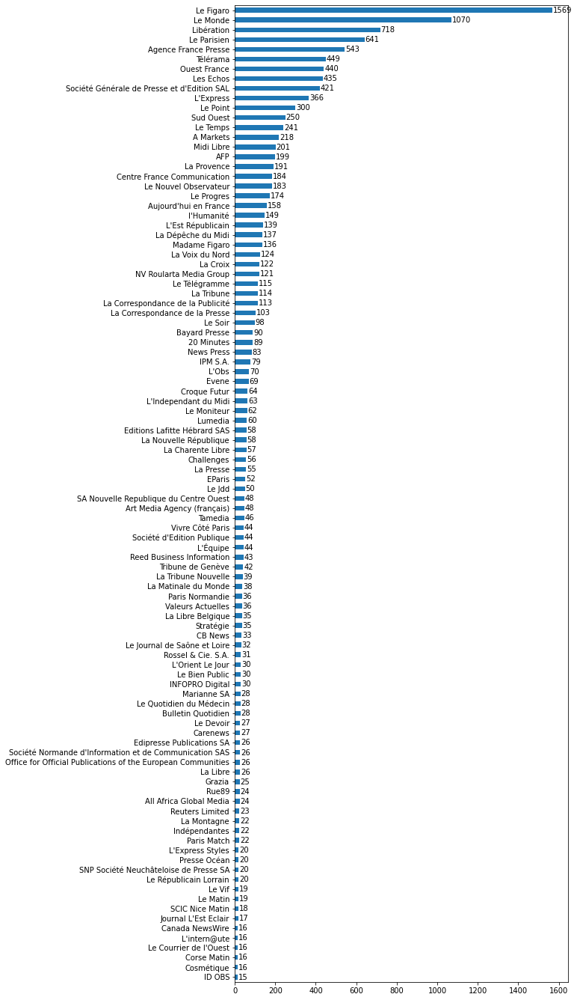

In [60]:
journal = corpus_fr['Journal'].value_counts().to_frame()
journal.head(100).plot.barh(legend=None,figsize=(8,24)).invert_yaxis()
for i, v in enumerate(journal.head(100)['Journal']):
    plt.text(v + 3, i + .25, str(v), color='black')

In [14]:
journal.to_csv('journal_fr_re.csv')

In [15]:
corpus_fr

,Date,Journal,Author,Title,Content,Language,LenContent
0,2000-01-06,Le Figaro,VIRGINIE MOUZAT,"Chic, le luxe revient",Y a-t-il un lien entre le fait que la société ...,fr,5201
1,2000-01-08,l'Humanité,"GUÉHENNEUX, LISE; WIDEMANN, DOMINIQUE","Pendant la polémique, l'art contemporain continue","Vue de l'étranger, la polémique sur l'art cont...",fr,8515
2,2000-01-08,l'Humanité,NaN,Peintre,"J'ai joint ma signature, au mois de juin derni...",fr,7329
3,2000-01-12,Le Figaro,"FRANÇOISE DE MAULDE, CAROLINE GAUDE, CAROLINE ...",Quoi de neuf aux musées,"Nouveautés, rénovations, déménagements De la n...",fr,6504
4,2000-02-03,L'Express,GANDILLOT THIERRY; LIBAN LAURENCE,Catherine Trautmann C'est le ministre qui décide,Le ministère de la Culture traverse une zone d...,fr,3324
...,...,...,...,...,...,...,...
14095,2021-06-14,Libération,LIBERATION,Les rues d'Israël fêtent le départ de Nétanyah...,Les rues d'Israël fêtent le départ de Nétanyah...,fr,4841
14096,2021-06-14,Libération,JUDICAËL LAVRADOR,ANNE IMHOF au bonheur dédale,e premier geste d'Anne Imhof L aura été de...,fr,8468
14097,2021-06-15,Le Figaro,"BOSIO, ALICE, DE SAINT PHALLE, HUGO",Six nouvelles terrasses gourmandes pour profit...,LA PLUS DOLCE VITA: BAMBINI CARTE: 25-60 €. ...,fr,7963
14098,2021-06-15,Le Figaro,"MABILON, LÉA, DE SANTIS, SOPHIE",Nos adresses favorites pour s’aérer et retrouv...,"Folie town, notre village de vacances à la Vil...",fr,9402


### visualiser les taills de contenus en graphe !

<AxesSubplot:ylabel='LenContent'>

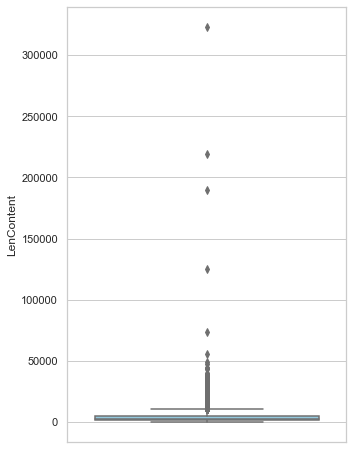

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(5,8)) 
sns.set(style="whitegrid")

sns.set(style="whitegrid")
sns.color_palette("pastel")
#sns.violinplot(y='LenContent', data=corpus_fr, alpha=0.2, color='lightsteelblue')
sns.boxplot(y='LenContent', data=corpus_fr, color='skyblue')
#sns.boxplot(x='Year',y='LenContent', palette='Blues', data=corpus_fr)

In [16]:
cpfrdes = DataFrame(corpus_fr['LenContent'].describe()).T.round(1)
cpfrdes.to_csv('cpfrdes.csv')

In [17]:
cpfrdes

,count,mean,std,min,25%,50%,75%,max
LenContent,14100.0,4013.4,5537.4,11.0,1474.0,2870.5,5060.2,323191.0


In [18]:
check = corpus_fr.sort_values(by="LenContent" , ascending=False)
#check

In [19]:
#check.loc[1244,'Title']

In [21]:
corpusfr = corpus_fr['Content'].str.lower()
corpusfr = corpusfr.str.replace('\'', '’')
corpusfr = corpusfr.str.replace("l’", "")
corpusfr = corpusfr.str.replace('avenue de new-york', 'avenue_de_New_york')
corpusfr = corpusfr.str.replace('avenue du président-wilson', 'avenue_du_Président_Wilson')
corpusfr = corpusfr.str.replace('palais de tokyo', 'palais_de_tokyo')
corpusfr = corpusfr.str.replace('tokyo art club', 'tokyo_art_club')
corpusfr = corpusfr.str.replace('new york', 'new_york')
corpusfr = corpusfr.str.replace('hong kong', 'hong_kong')
corpusfr = corpusfr.str.replace('hip-hop', 'hip_hop')
corpusfr = corpusfr.str.replace('hip hop', 'hip_hop')
corpusfr = corpusfr.str.replace('table-ronde', 'table_ronde')
corpusfr = corpusfr.str.replace('table ronde', 'table_ronde')
corpusfr = corpusfr.str.replace('tables rondes', 'table_ronde')
corpusfr = corpusfr.str.replace('art contemporain', 'art_contemporain')
corpusfr = corpusfr.str.replace('art moderne', 'art_Moderne')
corpusfr = corpusfr.str.replace('histoire de l’art', 'histoire_de_l’art')
corpusfr = corpusfr.str.replace('œuvres d’art', 'œuvres_d’art')
corpusfr = corpusfr.str.replace('œuvre d’art', 'œuvre_d’art')
corpusfr = corpusfr.str.replace('objet d’art', 'objet_d’art')
corpusfr = corpusfr.str.replace('Musée d’art', 'Musée_d’art')
corpusfr = corpusfr.str.replace('historiens d’art', 'historiens_d’art')
corpusfr = corpusfr.str.replace('historien d’art', 'historien_d’art')
corpusfr = corpusfr.str.replace('d’art urbain', 'art_urbain')
corpusfr = corpusfr.str.replace('musée d’art contemporain', 'musée_d’art_contemporain ')
corpusfr = corpusfr.str.replace('critique d’art', 'critique_d’art')
corpusfr = corpusfr.str.replace('critiques d’art', 'critiques_d’art')
corpusfr = corpusfr.str.replace('écoles d’art', 'écoles_d’art')
corpusfr = corpusfr.str.replace('école d’art', 'école_d’art') 
corpusfr = corpusfr.str.replace('amateurs d’art', 'amateurs_d’art') 
corpusfr = corpusfr.str.replace('amateur d’art', 'amateurs_d’art') 
corpusfr = corpusfr.str.replace('collection d’art', 'collection_d’art') 
corpusfr = corpusfr.str.replace('centre d’art', 'centre_d’art')
corpusfr = corpusfr.str.replace('centres d’art', 'centres_d’art')
corpusfr = corpusfr.str.replace('paris ass book fair', 'Paris_Ass_Book_Fair')

corpusfr = corpusfr.str.replace('«', ' ')
corpusfr = corpusfr.str.replace('»', ' ')
corpusfr = corpusfr.str.replace('’', ' ')

#corpusfr = corpusfr.str.replace('d’artiste', 'artiste')
#corpusfr = corpusfr.str.replace('d’artistes', 'artiste')
#corpusfr = corpusfr.str.replace('artistes', 'artiste')

#corpusfr = corpusfr.str.replace('john giorno', 'John_Giorno')
#corpusfr = corpusfr.str.replace('marcela iacub ', 'Marcela_Iacub')
#corpusfr = corpusfr.str.replace('johanne bouvier', 'Johanne_Bouvier')
#corpusfr = corpusfr.str.replace('jeremy rifkin', 'Jeremy_Rifkin')
#corpusfr = corpusfr.str.replace('keiichiro shibuya', 'Keiichiro_Shibuya')
#corpusfr = corpusfr.str.replace('lucio fontana', 'Lucio_Fontana')
#corpusfr = corpusfr.str.replace('vittoria matarrese', 'Vittoria_Matarrese')
#corpusfr = corpusfr.str.replace('jean michel frodon', 'Jean_Michel_Frodon')
#corpusfr = corpusfr.str.replace('marcel duchamp', 'Marcel_Duchamp')
#corpusfr = corpusfr.str.replace('andy warhol', 'Andy_Warhol')
#corpusfr = corpusfr.str.replace('takashi murakami', 'Takashi_Murakami')


#corpusfr = corpusfr.str.replace('yves saint laurent', 'Yves_Saint_Laurent')
#corpusfr = corpusfr.str.replace('pavillon neuflize obc', 'Pavillon_Neufliz_Obc')
#corpusfr = corpusfr.str.replace('jean pierre ceton', 'Jean_Pierre_Ceton')
#corpusfr = corpusfr.str.replace('john cage', 'John_Cage')
#corpusfr = corpusfr.str.replace('juan pérez agirregoikoa', 'Juan_Pérez_Agirregoikoa')
#corpusfr = corpusfr.str.replace('Centre Georges Pompidou', 'Centre_Georges_Pompidou')


corpusfr = list(corpusfr)
corpusfr

['y a-t-il un lien entre le fait que la société américaine de gestion de portefeuilles privés merill lynch ouvre un second bureau de   private banking   et la réouverture du palace george v sous bannière américaine four season s ? sans doute. le premier s installe avenue montaigne, le deuxième rehausse une des avenues les plus luxueuses du 8e arrondissement. énergie de la grosse pomme semble traverser atlantique pour apporter avec elle un retour de la prospérité dans la capitale. immobilier fait un boom, paris retrouve son lustre, ses quartiers sont réinvestis. argent fait son retour en ville et avec lui ses signes extérieurs de richesse.   lorsqu on pénètre dans immense hall de marbre du palace, on savoure immédiatement les travaux 750 millions entrepris afin de rajeunir la grande bâtisse. seules 50 personnes de ancien personnel ont subsisté. les nouvelles recrues sont jeunes, très jeunes et ont encore un peu de mal à vous indiquer les salles de bains du palace, propriété du prince al

## modélisationn de sujet

In [209]:
print(corpusfr, file=open("output.txt", "a"))

In [22]:
import re
import string
from spacy.lang.fr.stop_words import STOP_WORDS as fr_stop
from spacy.lang.en.stop_words import STOP_WORDS as en_stop
from nltk.stem import WordNetLemmatizer

In [23]:
stopWords_more = ['«','»',"h","er","e","cest","nont","en","dun","dune","€","dart","c'est","y","euro","quil","très","m","q","atil","sil",
                 "estil","jusqu’à","sest","s’est","n’est", "c’est", "d’un","d’une","un","d’autres","d’euros","celleci","m°","l’on","an",
                  "ème","kg","tél","sest","jusqu’au", "faire", "qu", "l", "qu’il", "y", "n", "plupart", "autour", "qu’à",
                 "n’en", "qu’un", "–", "ici", "min", "p", "s", "pas", "mot", "x", "mix", "an", "quon", "art", "l’art", "d’art",
                  "×","et…","j","…","k","u","m",
                 "choses","d","mot","fois","—","•","b","mois","’","ère","liés","qu’elle","mot","grâce","→","‚ä≤","‚ä¢","d’en","non","l",
                 "venez","hh","ans","éd","ensemble","qu'il", "jusqu’ici","années","van","joep","wim","d’entrée","aka","twittershare","m’a",
                  "j’étais","qu’ils","c’étais","·","c","”","th","qu’ils","mon","ton","son","leur","ca","st","mme","”","n","faut","c’était",
                  "mailshare","facecbookshare","d’être","artiste","j’ai","déjà","v","t","ii","iv","vi","tlj","·","c","”","“"]
names = ["palaisdetokyo","facebook","david","tom","anne","vincent","von","michel","charle","nicolas","twitter","jean", "alain","camille",
         "mars","alix","yves","alice","laure","ben","sara","sarah","julie","paul","laurant","emile","adrien","denis","alexis","cécile",
         "robert","delphine","gilles","julius","christophe","jeanchristophe","adélaïde","veilhan","françois","macron","poincheval",
         "malkin","duchat","marcel","alexandra","xavier","jérôme","klein","viennent","roger","fedrico","sam","lucas","gerald","stéphane",
         "fabien","abdellah","VittoriaMatarrese","emmanuelle","karroum","hélène","josèfa","ntjam","di","moulton","raphaël","bruguera",
         "violaine","julien","lafon","bruguera","christian","rossi","lefebvre","noé","soulier","lewis","jonathan","chang","alexander",
         "JohnGiorno","justin","pauline","simon","tania","thomas","emanuele","patrick","louise","jeanmichel","john","gwenaël","léa","licia",
         "demuro","catherine","nemeth","caroline","laurent","charlie","claire","charlie","dominique","julia","jeremy","theaster","gates",
         "holmes","arthur","ladj","ly","george","callas","Rita","alan","pascal","olivier","lee","jr","jeanbaptiste","garcia","georges",
         "nyssen","huang","baumann","sabina","houellebecq","lacaton",
         "federico","guillaume","vassal","weerasethakul","apichatpong","gabriel","augustyniak","évelyne","andrieu","michael","jeanphilippe"]
days = ["lundi","mardi","mercredi","jeudi","vendredi","samedi","dimanche"]
months = ["janvier","février","mars","avril","mai","juin","juillet","août","septembre","octobre","novembre","décembre"]

stopWords = list(fr_stop) + list(en_stop) + stopWords_more + days + months
exclude = set(string.punctuation)
lemma = WordNetLemmatizer()

def clean(corpusfr):
    nonum_free = re.sub(r'\d+', '', corpusfr)
    punc_free = "".join(p for p in nonum_free if p not in exclude)
    doublespace_free = re.sub('\s+', ' ', punc_free).strip()
    stop_free = " ".join([i for i in doublespace_free.split() if i not in stopWords])
    normalized = " ".join(lemma.lemmatize(word) for word in stop_free.split())

    return normalized

corpusfr_clean = [clean(doc).split() for doc in corpusfr]
corpusfr_clean

[['lien',
  'société',
  'américaine',
  'gestion',
  'portefeuilles',
  'privés',
  'merill',
  'lynch',
  'ouvre',
  'second',
  'bureau',
  'private',
  'banking',
  'réouverture',
  'palace',
  'george',
  'bannière',
  'américaine',
  'season',
  'doute',
  'installe',
  'avenue',
  'montaigne',
  'rehausse',
  'avenue',
  'luxueuses',
  'arrondissement',
  'énergie',
  'grosse',
  'pomme',
  'traverser',
  'atlantique',
  'apporter',
  'prospérité',
  'capitale',
  'immobilier',
  'boom',
  'paris',
  'retrouve',
  'lustre',
  'quartiers',
  'réinvestis',
  'argent',
  'ville',
  'signes',
  'extérieurs',
  'richesse',
  'lorsqu',
  'pénètre',
  'immense',
  'hall',
  'marbre',
  'palace',
  'savoure',
  'immédiatement',
  'travaux',
  'million',
  'entrepris',
  'rajeunir',
  'grande',
  'bâtisse',
  'seules',
  'personnes',
  'ancien',
  'personnel',
  'subsisté',
  'nouvelles',
  'recrues',
  'jeunes',
  'jeunes',
  'mal',
  'indiquer',
  'salles',
  'bains',
  'palace',
  'pr

In [327]:
type(corpusfr_clean)

list

In [24]:
import gensim
from gensim import corpora
from gensim.corpora import Dictionary
from gensim.models import ldamodel
from gensim.models import CoherenceModel, LdaModel
from gensim import models

In [25]:
dictionary = corpora.Dictionary(corpusfr_clean)
doc_term_matrix_fr = [dictionary.doc2bow(doc) for doc in corpusfr_clean]

In [758]:

#ldamodel_fr = gensim.models.ldamodel.LdaModel(doc_term_matrix_fr, num_topics=100, id2word = dictionary, alpha='symmetric',per_word_topics=True)

#ldamodel_fr = gensim.models.LdaMulticore(doc_term_matrix_fr, num_topics=12, id2word = dictionary, alpha='symmetric',per_word_topics=True)

In [28]:
# Compute Coherence Score using c_v
coherence_model_lda_fr = CoherenceModel(model=ldamodel_fr, texts=corpusfr_clean, dictionary=dictionary, coherence='c_v')
coherence_lda_fr = coherence_model_lda_fr.get_coherence()
print('\nCoherence Score: ', coherence_lda_fr)


Coherence Score:  0.5156239377460153


In [29]:
num_topics = 100

In [30]:
def get_lda_topics(model, num_topics):
    word_dict = {};
    for i in range(num_topics):
        words = model.show_topic(i, topn = 50);
        word_dict['Topic # ' + str(int(i)+1)] = [i[0] for i in words];
    return pd.DataFrame(word_dict);

In [31]:
fr_topic = get_lda_topics(ldamodel_fr, num_topics)
fr_topic.index = fr_topic.index + 1
fr_topic.T.tail(50)

,1,2,3,4,5,6,7,8,9,10,...,41,42,43,44,45,46,47,48,49,50
Topic # 51,france,mot,cylindre,pay,paris,houellebecq,monde,épidémie,semaine,police,...,image,débarquer,article,etatsunis,société,politique,sommet,capte,plaidoyer,pris
Topic # 52,galerie,exposition,museum,newyork,sturtevant,paris,né,whitney,suisse,vit,...,photographe,peintre,rétrospective,rotterdam,sculpture,brooklyn,image,jaillir,charleroi,fondation
Topic # 53,paris,rue,france,presse,conférence,place,salle,édition,ministre,social,...,soirée,secrétaire,événement,club,groupe,europe,fédération,point,sport,santé
Topic # 54,coulures,bestiaire,mile,limit,vagabondage,valley,bergamote,tilda,graffeur,swinton,...,émeraude,goose,musée,oies,personnage,flammes,baiser,graffiti,contrastent,performance
Topic # 55,pinault,artiste,fondation,oeuvre,collection,musées,million,commerce,françois,bourse,...,vendre,directeur,mécénat,conservatrice,duma,ouverture,musée,dollar,pay,île
Topic # 56,monde,beaucoup,usure,temp,désir,corp,voix,bien,lira,peur,...,forme,danseur,écrit,rhétorique,marocaine,miséreux,deuxlà,paradox,précoce,chine
Topic # 57,québec,reuilly,maine,rue,paris,ringier,xvi,avenue,adobe,ballu,...,conférence,théâtre,xii,palaisdetokyo,demain,ix,national,québécois,prix,groupe
Topic # 58,olympe,newsletter,portedrapeaux,benhamouhuet,betc,résidents,judith,rafael,frotte,conçois,...,printanière,dazed,conforte,oeuvre,coïncidences,reproduisent,musée,artiste,euro,alfortville
Topic # 59,society,jauge,cooky,trump,m€,zana,quantités,green,étiez,amazon,...,contactés,rimer,alignent,galettes,thermiques,cambridge,fantasy,terrain,resort,mister
Topic # 60,éventualité,grm,platitude,télévisuelles,schaeffer,ar,malles,darren,fluctuante,centre,...,travail,projet,palaisdetokyo,stabilisation,cinéma,public,scène,institution,maison,musée


In [101]:
fr_topic.T.to_csv('topic_fr_modèle2_sujet100.csv', index=1, header=True)

https://www.machinelearningplus.com/nlp/topic-modeling-visualization-how-to-present-results-lda-models/

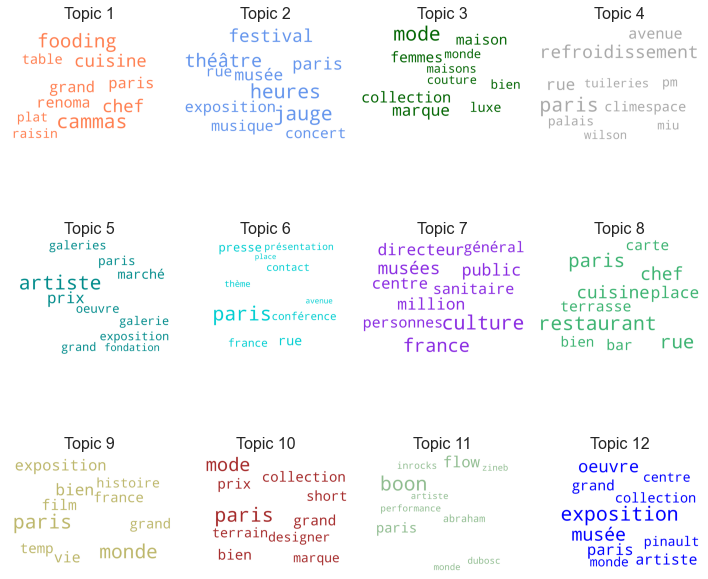

In [319]:
# 1. Wordcloud of Top N words in each topic
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors


cols = ['coral','cornflowerblue','darkgreen','darkgray','darkcyan','darkturquoise','blueviolet','mediumseagreen','darkkhaki',
        'brown','darkseagreen','blue','crimson','orchid','navy','limegreen','midnightblue','lightsalmon','gold','thistle']

cloud = WordCloud(stopwords=stopWords,
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=50,
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = ldamodel_fr.show_topics(formatted=False, num_topics=40)

fig, axes = plt.subplots(3, 4, figsize=(10,10), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i+1), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.show()

In [27]:
#ldamodel_fr.show_topics(formatted=False, num_topics=40)

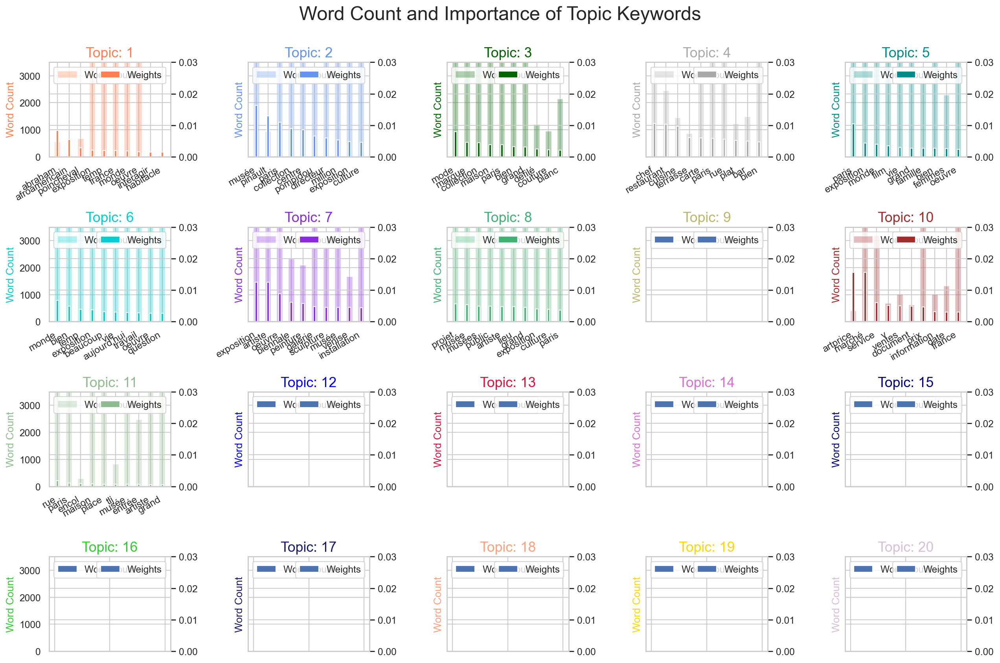

In [37]:
from collections import Counter
topics = ldamodel_fr.show_topics(formatted=False)
data_flat = [w for w_list in corpusfr_clean for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(4, 5, figsize=(16,10), sharey=True, dpi=160)
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylim(0, 0.030); ax.set_ylim(0, 3500)
    ax.set_title('Topic: ' + str(i+1), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)    
plt.show()

In [134]:
import pyLDAvis
import warnings
try:
  import pyLDAvis.gensim
  CAN_VISUALIZE = True
  pyLDAvis.enable_notebook()
  from IPython.display import display
except ImportError:
    ValueError("SKIP: please install pyLDAvis")
    CAN_VISUALIZE = False
warnings.filterwarnings('ignore') 
%matplotlib inline

prepared = pyLDAvis.gensim.prepare(ldamodel_fr, doc_term_matrix_fr, dictionary)
pyLDAvis.display(prepared)

ValidationError: 
 * Not all rows (distributions) in topic_term_dists sum to 1.

https://datascienceplus.com/evaluation-of-topic-modeling-topic-coherence/ 

In [193]:
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model=gensim.models.ldamodel.LdaModel(doc_term_matrix_fr, num_topics=num_topics, id2word = dictionary, 
                                         alpha='symmetric',per_word_topics=True)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values

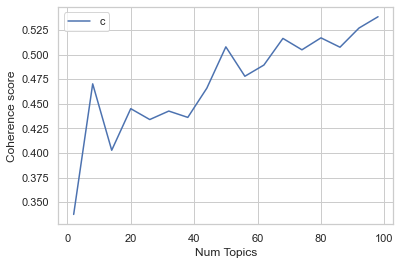

In [252]:
model_list, coherence_values = compute_coherence_values(dictionary=dictionary, 
                                                        corpus=doc_term_matrix_fr, texts=corpusfr_clean, 
                                                        start=2, limit=100, step=6)
# Show graph
import matplotlib.pyplot as plt
limit=100; start=2; step=6;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

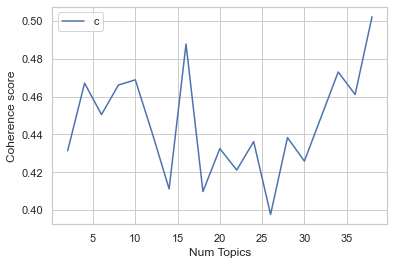

In [30]:
model_list, coherence_values = compute_coherence_values(dictionary=dictionary, 
                                                        corpus=doc_term_matrix_fr, texts=corpusfr_clean, 
                                                        start=2, limit=40, step=2)
# Show graph
import matplotlib.pyplot as plt
limit=40; start=2; step=2;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

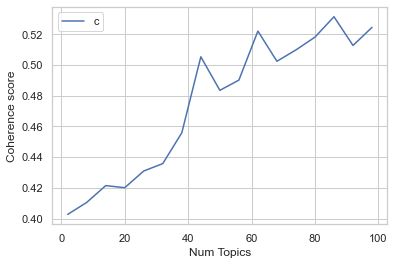

In [31]:
model_list, coherence_values = compute_coherence_values(dictionary=dictionary, 
                                                        corpus=doc_term_matrix_fr, texts=corpusfr_clean, 
                                                        start=2, limit=100, step=6)
# Show graph
import matplotlib.pyplot as plt
limit=100; start=2; step=6;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

In [33]:
def format_topics_sentences(ldamodel=None, corpus=doc_term_matrix_fr, texts=corpusfr_clean):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list            
        # print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)


df_topic_sents_keywords = format_topics_sentences(ldamodel=ldamodel_fr, corpus=doc_term_matrix_fr, texts=corpusfr_clean)

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.reset_index(drop=True)
df_dominant_topic.index = df_dominant_topic.index + 1
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']
df_dominant_topic

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
1,0,86.0,0.4079,"rue, paris, chef, cuisine, carte, restaurant, ...","[lien, société, américaine, gestion, portefeui..."
2,1,81.0,0.5133,"artiste, exposition, palaisdetokyo, artcontemp...","[vue, étranger, polémique, artcontemporain, mé..."
3,2,81.0,0.5188,"artiste, exposition, palaisdetokyo, artcontemp...","[joint, signature, dernier, appel, répondu, ce..."
4,3,8.0,0.6370,"musée, exposition, oeuvre, collection, palais,...","[nouveautés, rénovations, déménagements, naiss..."
5,4,65.0,0.5899,"paris, monde, bien, vie, grand, palaisdetokyo,...","[ministère, culture, traverse, zone, fortes, t..."
...,...,...,...,...,...
14096,14095,NaN,NaN,NaN,"[rue, israël, fêtent, départ, nétanyahou, algé..."
14097,14096,NaN,NaN,NaN,"[geste, anne, imhof, dépouiller, o, palaisdeto..."
14098,14097,NaN,NaN,NaN,"[dolce, vita, bambino, carte, av, présidentwil..."
14099,14098,NaN,NaN,NaN,"[folie, town, village, vacances, villette, gui..."


In [34]:
num_topics = 100
list_topic = []
for i in df_dominant_topic['Dominant_Topic']:
    if i == i:
        i = ('Topic # ' + str(int(i)+1))
    else:
        i = i
    list_topic.append(i)
df_dominant_topic['Dominant_Topic'] = list_topic
df_dominant_topic['Dominant_Topic']

1        Topic # 87
2        Topic # 82
3        Topic # 82
4         Topic # 9
5        Topic # 66
            ...    
14096           NaN
14097           NaN
14098           NaN
14099           NaN
14100           NaN
Name: Dominant_Topic, Length: 14100, dtype: object

In [31]:
num_topics = 100
list_topic = []
for i in df_dominant_topic['Dominant_Topic']:
    if i == i:
        i = ('Topic # ' + str(int(i)+1))
    else:
        i = i
    list_topic.append(i)
df_dominant_topic['Dominant_Topic'] = list_topic
df_dominant_topic['Dominant_Topic']

ValueError: invalid literal for int() with base 10: 'Topic # 87'

In [35]:
df_dominant_topic

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
1,0,Topic # 87,0.4079,"rue, paris, chef, cuisine, carte, restaurant, ...","[lien, société, américaine, gestion, portefeui..."
2,1,Topic # 82,0.5133,"artiste, exposition, palaisdetokyo, artcontemp...","[vue, étranger, polémique, artcontemporain, mé..."
3,2,Topic # 82,0.5188,"artiste, exposition, palaisdetokyo, artcontemp...","[joint, signature, dernier, appel, répondu, ce..."
4,3,Topic # 9,0.6370,"musée, exposition, oeuvre, collection, palais,...","[nouveautés, rénovations, déménagements, naiss..."
5,4,Topic # 66,0.5899,"paris, monde, bien, vie, grand, palaisdetokyo,...","[ministère, culture, traverse, zone, fortes, t..."
...,...,...,...,...,...
14096,14095,NaN,NaN,NaN,"[rue, israël, fêtent, départ, nétanyahou, algé..."
14097,14096,NaN,NaN,NaN,"[geste, anne, imhof, dépouiller, o, palaisdeto..."
14098,14097,NaN,NaN,NaN,"[dolce, vita, bambino, carte, av, présidentwil..."
14099,14098,NaN,NaN,NaN,"[folie, town, village, vacances, villette, gui..."


In [36]:
df_dominant_topic['Dominant_Topic'].tail(50)

14051     Topic # 1
14052    Topic # 74
14053    Topic # 10
14054    Topic # 87
14055     Topic # 1
14056     Topic # 1
14057    Topic # 94
14058    Topic # 87
14059    Topic # 87
14060    Topic # 75
14061     Topic # 9
14062    Topic # 10
14063    Topic # 10
14064     Topic # 1
14065    Topic # 94
14066    Topic # 70
14067    Topic # 34
14068    Topic # 87
14069    Topic # 34
14070    Topic # 16
14071    Topic # 87
14072     Topic # 9
14073    Topic # 87
14074    Topic # 87
14075    Topic # 87
14076    Topic # 87
14077    Topic # 74
14078    Topic # 10
14079    Topic # 66
14080    Topic # 87
14081    Topic # 16
14082    Topic # 87
14083    Topic # 66
14084    Topic # 82
14085    Topic # 87
14086     Topic # 9
14087     Topic # 5
14088    Topic # 66
14089    Topic # 87
14090    Topic # 87
14091    Topic # 19
14092           NaN
14093           NaN
14094           NaN
14095           NaN
14096           NaN
14097           NaN
14098           NaN
14099           NaN
14100           NaN


In [37]:
from natsort import natsorted
tp_count = df_dominant_topic["Dominant_Topic"].value_counts().to_frame()
tp_count = tp_count.reindex(natsorted(tp_count.index))
tp_count.columns = ['Numbers']
tp_count

,Numbers
Topic # 1,456
Topic # 2,1
Topic # 4,26
Topic # 5,143
Topic # 6,501
...,...
Topic # 93,3
Topic # 94,1022
Topic # 98,1
Topic # 99,6


In [38]:
tp_count.describe().round(1).T

,count,mean,std,min,25%,50%,75%,max
Numbers,63.0,223.7,573.4,1.0,2.0,15.0,176.0,4144.0


In [39]:
tp_ten = tp_count[tp_count['Numbers'] >= 100].reset_index()
tp_ten.index = tp_ten.index + 1
tp_ten.columns = ['Dominant_Topic','Numbers']
tp_ten

,Dominant_Topic,Numbers
1,Topic # 1,456
2,Topic # 5,143
3,Topic # 6,501
4,Topic # 9,1038
5,Topic # 10,754
6,Topic # 16,106
7,Topic # 19,174
8,Topic # 23,414
9,Topic # 34,285
10,Topic # 43,294


<AxesSubplot:>

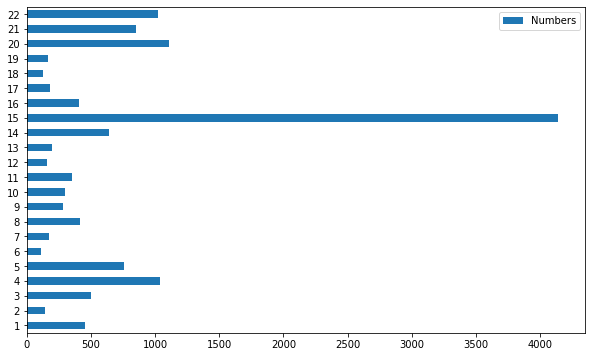

In [40]:
tp_ten.plot.barh(figsize=(10,6))

In [41]:
def frequent_topics(tp_ten, fr_topic):
    frequent_topics= pd.DataFrame()
    for i in tp_ten['Dominant_Topic'].tolist():
        frequent_topics = frequent_topics.append(fr_topic[i])
        
#    frequent_topics = pd.concat([tp_count[tp_count['Numbers'] >= 50],frequent_topics],axis=1)
    return frequent_topics

In [375]:
#frequent_topics(tp_ten, fr_topic)

In [50]:
frequent_topics(tp_ten, fr_topic).to_csv('top_topic_fr.csv', index=1, header=True)

In [1737]:
ldamodel_fr.save('lda_fr_100.model')

In [27]:
ldamodel_fr = LdaModel.load('lda_fr_100.model')

In [378]:
# Get topic weights and dominant topics ------------
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook
import numpy as np
import matplotlib.colors as mcolors

# Get topic weights
topic_weights = []
for i, row_list in enumerate(ldamodel_fr[doc_term_matrix_fr]):
    topic_weights.append([w for i, w in row_list[0]])

# Array of topic weights    
arr = pd.DataFrame(topic_weights).fillna(0).values

# Keep the well separated points (optional)
arr = arr[np.amax(arr, axis=1) > 0.35]

# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

# tSNE Dimension Reduction
tsne_model = TSNE(n_components=2, verbose=1, random_state=0, angle=.99, init='pca')
tsne_lda = tsne_model.fit_transform(arr)

# Plot the Topic Clusters using Bokeh
output_notebook()
n_topics = 20
mycolors = np.array(cols)
plot = figure(title="t-SNE Clustering of {} LDA Topics".format(n_topics), 
              plot_width=900, plot_height=700)
plot.scatter(x=tsne_lda[:,0], y=tsne_lda[:,1], color=mycolors[topic_num],alpha=0.3)
show(plot)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8697 samples in 0.042s...
[t-SNE] Computed neighbors for 8697 samples in 1.187s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8697
[t-SNE] Computed conditional probabilities for sample 2000 / 8697
[t-SNE] Computed conditional probabilities for sample 3000 / 8697
[t-SNE] Computed conditional probabilities for sample 4000 / 8697
[t-SNE] Computed conditional probabilities for sample 5000 / 8697
[t-SNE] Computed conditional probabilities for sample 6000 / 8697
[t-SNE] Computed conditional probabilities for sample 7000 / 8697
[t-SNE] Computed conditional probabilities for sample 8000 / 8697
[t-SNE] Computed conditional probabilities for sample 8697 / 8697
[t-SNE] Mean sigma: 0.038703
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.091919
[t-SNE] KL divergence after 1000 iterations: 1.370568


Loading BokehJS ...

IndexError: index 23 is out of bounds for axis 0 with size 20

In [43]:
corpus_fr['Year']=corpus_fr['Date'].dt.year
#corpus_fr.index = corpus_fr.index + 1
corpus_fr

,Date,Journal,Author,Title,Content,Language,LenContent,Year
1,2000-01-06,Le Figaro,VIRGINIE MOUZAT,"Chic, le luxe revient",Y a-t-il un lien entre le fait que la société ...,fr,5201,2000
2,2000-01-08,l'Humanité,"GUÉHENNEUX, LISE; WIDEMANN, DOMINIQUE","Pendant la polémique, l'art contemporain continue","Vue de l'étranger, la polémique sur l'art cont...",fr,8515,2000
3,2000-01-08,l'Humanité,NaN,Peintre,"J'ai joint ma signature, au mois de juin derni...",fr,7329,2000
4,2000-01-12,Le Figaro,"FRANÇOISE DE MAULDE, CAROLINE GAUDE, CAROLINE ...",Quoi de neuf aux musées,"Nouveautés, rénovations, déménagements De la n...",fr,6504,2000
5,2000-02-03,L'Express,GANDILLOT THIERRY; LIBAN LAURENCE,Catherine Trautmann C'est le ministre qui décide,Le ministère de la Culture traverse une zone d...,fr,3324,2000
...,...,...,...,...,...,...,...,...
14096,2021-06-14,Libération,LIBERATION,Les rues d'Israël fêtent le départ de Nétanyah...,Les rues d'Israël fêtent le départ de Nétanyah...,fr,4841,2021
14097,2021-06-14,Libération,JUDICAËL LAVRADOR,ANNE IMHOF au bonheur dédale,e premier geste d'Anne Imhof L aura été de...,fr,8468,2021
14098,2021-06-15,Le Figaro,"BOSIO, ALICE, DE SAINT PHALLE, HUGO",Six nouvelles terrasses gourmandes pour profit...,LA PLUS DOLCE VITA: BAMBINI CARTE: 25-60 €. ...,fr,7963,2021
14099,2021-06-15,Le Figaro,"MABILON, LÉA, DE SANTIS, SOPHIE",Nos adresses favorites pour s’aérer et retrouv...,"Folie town, notre village de vacances à la Vil...",fr,9402,2021


In [44]:
#df_topic_descrip = pd.concat([corpus_fr, df_dominant_topic], axis=1)
df_topic_descrip

,Date,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
1,2000-01-06,Le Figaro,VIRGINIE MOUZAT,"Chic, le luxe revient",Y a-t-il un lien entre le fait que la société ...,fr,5201,2000,0,Topic # 87,0.4079,"rue, paris, chef, cuisine, carte, restaurant, ...","[lien, société, américaine, gestion, portefeui..."
2,2000-01-08,l'Humanité,"GUÉHENNEUX, LISE; WIDEMANN, DOMINIQUE","Pendant la polémique, l'art contemporain continue","Vue de l'étranger, la polémique sur l'art cont...",fr,8515,2000,1,Topic # 82,0.5133,"artiste, exposition, palaisdetokyo, artcontemp...","[vue, étranger, polémique, artcontemporain, mé..."
3,2000-01-08,l'Humanité,NaN,Peintre,"J'ai joint ma signature, au mois de juin derni...",fr,7329,2000,2,Topic # 82,0.5188,"artiste, exposition, palaisdetokyo, artcontemp...","[joint, signature, dernier, appel, répondu, ce..."
4,2000-01-12,Le Figaro,"FRANÇOISE DE MAULDE, CAROLINE GAUDE, CAROLINE ...",Quoi de neuf aux musées,"Nouveautés, rénovations, déménagements De la n...",fr,6504,2000,3,Topic # 9,0.6370,"musée, exposition, oeuvre, collection, palais,...","[nouveautés, rénovations, déménagements, naiss..."
5,2000-02-03,L'Express,GANDILLOT THIERRY; LIBAN LAURENCE,Catherine Trautmann C'est le ministre qui décide,Le ministère de la Culture traverse une zone d...,fr,3324,2000,4,Topic # 66,0.5899,"paris, monde, bien, vie, grand, palaisdetokyo,...","[ministère, culture, traverse, zone, fortes, t..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
14096,2021-06-14,Libération,LIBERATION,Les rues d'Israël fêtent le départ de Nétanyah...,Les rues d'Israël fêtent le départ de Nétanyah...,fr,4841,2021,14095,NaN,NaN,NaN,"[rue, israël, fêtent, départ, nétanyahou, algé..."
14097,2021-06-14,Libération,JUDICAËL LAVRADOR,ANNE IMHOF au bonheur dédale,e premier geste d'Anne Imhof L aura été de...,fr,8468,2021,14096,NaN,NaN,NaN,"[geste, anne, imhof, dépouiller, o, palaisdeto..."
14098,2021-06-15,Le Figaro,"BOSIO, ALICE, DE SAINT PHALLE, HUGO",Six nouvelles terrasses gourmandes pour profit...,LA PLUS DOLCE VITA: BAMBINI CARTE: 25-60 €. ...,fr,7963,2021,14097,NaN,NaN,NaN,"[dolce, vita, bambino, carte, av, présidentwil..."
14099,2021-06-15,Le Figaro,"MABILON, LÉA, DE SANTIS, SOPHIE",Nos adresses favorites pour s’aérer et retrouv...,"Folie town, notre village de vacances à la Vil...",fr,9402,2021,14098,NaN,NaN,NaN,"[folie, town, village, vacances, villette, gui..."


In [45]:
year_topic = df_topic_descrip[['Year', 'Dominant_Topic']]
year_topic

,Year,Dominant_Topic
1,2000,Topic # 87
2,2000,Topic # 82
3,2000,Topic # 82
4,2000,Topic # 9
5,2000,Topic # 66
...,...,...
14096,2021,NaN
14097,2021,NaN
14098,2021,NaN
14099,2021,NaN


In [46]:
df_topic_pressefr = df_topic_descrip.set_index('Date')

In [47]:
df_topic_pressefr

,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
Date,,,,,,,,,,,,
2000-01-06,Le Figaro,VIRGINIE MOUZAT,"Chic, le luxe revient",Y a-t-il un lien entre le fait que la société ...,fr,5201,2000,0,Topic # 87,0.4079,"rue, paris, chef, cuisine, carte, restaurant, ...","[lien, société, américaine, gestion, portefeui..."
2000-01-08,l'Humanité,"GUÉHENNEUX, LISE; WIDEMANN, DOMINIQUE","Pendant la polémique, l'art contemporain continue","Vue de l'étranger, la polémique sur l'art cont...",fr,8515,2000,1,Topic # 82,0.5133,"artiste, exposition, palaisdetokyo, artcontemp...","[vue, étranger, polémique, artcontemporain, mé..."
2000-01-08,l'Humanité,NaN,Peintre,"J'ai joint ma signature, au mois de juin derni...",fr,7329,2000,2,Topic # 82,0.5188,"artiste, exposition, palaisdetokyo, artcontemp...","[joint, signature, dernier, appel, répondu, ce..."
2000-01-12,Le Figaro,"FRANÇOISE DE MAULDE, CAROLINE GAUDE, CAROLINE ...",Quoi de neuf aux musées,"Nouveautés, rénovations, déménagements De la n...",fr,6504,2000,3,Topic # 9,0.6370,"musée, exposition, oeuvre, collection, palais,...","[nouveautés, rénovations, déménagements, naiss..."
2000-02-03,L'Express,GANDILLOT THIERRY; LIBAN LAURENCE,Catherine Trautmann C'est le ministre qui décide,Le ministère de la Culture traverse une zone d...,fr,3324,2000,4,Topic # 66,0.5899,"paris, monde, bien, vie, grand, palaisdetokyo,...","[ministère, culture, traverse, zone, fortes, t..."
...,...,...,...,...,...,...,...,...,...,...,...,...
2021-06-14,Libération,LIBERATION,Les rues d'Israël fêtent le départ de Nétanyah...,Les rues d'Israël fêtent le départ de Nétanyah...,fr,4841,2021,14095,NaN,NaN,NaN,"[rue, israël, fêtent, départ, nétanyahou, algé..."
2021-06-14,Libération,JUDICAËL LAVRADOR,ANNE IMHOF au bonheur dédale,e premier geste d'Anne Imhof L aura été de...,fr,8468,2021,14096,NaN,NaN,NaN,"[geste, anne, imhof, dépouiller, o, palaisdeto..."
2021-06-15,Le Figaro,"BOSIO, ALICE, DE SAINT PHALLE, HUGO",Six nouvelles terrasses gourmandes pour profit...,LA PLUS DOLCE VITA: BAMBINI CARTE: 25-60 €. ...,fr,7963,2021,14097,NaN,NaN,NaN,"[dolce, vita, bambino, carte, av, présidentwil..."


In [48]:
#mettre en oeuvre les dates précises
df_pdt_fr = df_topic_pressefr.loc['2002-1':'2021-6']

In [49]:
df_pdt_fr

,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
Date,,,,,,,,,,,,
2002-01-05,l'Humanité,NaN,La cité manifeste ou le logement autrement,"En 1853, des industriels de la haute société p...",fr,6460,2002,92,Topic # 75,0.2636,"anne, architecture, lacaton, vassal, logements...","[industriels, haute, société, protestante, mul..."
2002-01-11,NaN,JUDITH BENHAMOU HUET,Révolution de palais,Le 21 janvier prochain à Paris sera inauguré l...,fr,6280,2002,93,Topic # 82,0.4012,"artiste, exposition, palaisdetokyo, artcontemp...","[prochain, paris, inauguré, palaisdetokyo, sit..."
2002-01-11,AFP,NaN,Le Site de création contemporaine de Paris ina...,PARIS (AFP) - Le Site de création contemporain...,fr,1802,2002,94,Topic # 82,0.5156,"artiste, exposition, palaisdetokyo, artcontemp...","[paris, afp, site, création, contemporaine, vé..."
2002-01-15,AFP,NaN,Un musée d'art contemporain au sud de Paris fi...,VITRY-SUR-SEINE (Val-de-Marne) (AFP) - Un musé...,fr,1445,2002,95,Topic # 34,0.4145,"jauge, euro, salles, sanitaire, million, rédui...","[vitrysurseine, valdemarne, afp, musée, artcon..."
2002-01-15,AFP,NaN,Un nouveau musée d'art contemporain au sud de ...,VITRY-SUR-SEINE (France) (AFP) - Un musée d'ar...,fr,1532,2002,96,Topic # 34,0.3800,"jauge, euro, salles, sanitaire, million, rédui...","[vitrysurseine, france, afp, musée, artcontemp..."
...,...,...,...,...,...,...,...,...,...,...,...,...
2021-06-14,Libération,LIBERATION,Les rues d'Israël fêtent le départ de Nétanyah...,Les rues d'Israël fêtent le départ de Nétanyah...,fr,4841,2021,14095,NaN,NaN,NaN,"[rue, israël, fêtent, départ, nétanyahou, algé..."
2021-06-14,Libération,JUDICAËL LAVRADOR,ANNE IMHOF au bonheur dédale,e premier geste d'Anne Imhof L aura été de...,fr,8468,2021,14096,NaN,NaN,NaN,"[geste, anne, imhof, dépouiller, o, palaisdeto..."
2021-06-15,Le Figaro,"BOSIO, ALICE, DE SAINT PHALLE, HUGO",Six nouvelles terrasses gourmandes pour profit...,LA PLUS DOLCE VITA: BAMBINI CARTE: 25-60 €. ...,fr,7963,2021,14097,NaN,NaN,NaN,"[dolce, vita, bambino, carte, av, présidentwil..."


In [50]:
pdt_fr_sort = df_pdt_fr.sort_index()
pdt_fr_sort['TK']=pdt_fr_sort['Dominant_Topic']+': '+pdt_fr_sort['Keywords']
pdt_fr_sort

,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK
Date,,,,,,,,,,,,,
2002-01-05,l'Humanité,NaN,La cité manifeste ou le logement autrement,"En 1853, des industriels de la haute société p...",fr,6460,2002,92,Topic # 75,0.2636,"anne, architecture, lacaton, vassal, logements...","[industriels, haute, société, protestante, mul...","Topic # 75: anne, architecture, lacaton, vassa..."
2002-01-11,NaN,JUDITH BENHAMOU HUET,Révolution de palais,Le 21 janvier prochain à Paris sera inauguré l...,fr,6280,2002,93,Topic # 82,0.4012,"artiste, exposition, palaisdetokyo, artcontemp...","[prochain, paris, inauguré, palaisdetokyo, sit...","Topic # 82: artiste, exposition, palaisdetokyo..."
2002-01-11,AFP,NaN,Le Site de création contemporaine de Paris ina...,PARIS (AFP) - Le Site de création contemporain...,fr,1802,2002,94,Topic # 82,0.5156,"artiste, exposition, palaisdetokyo, artcontemp...","[paris, afp, site, création, contemporaine, vé...","Topic # 82: artiste, exposition, palaisdetokyo..."
2002-01-15,AFP,NaN,Un musée d'art contemporain au sud de Paris fi...,VITRY-SUR-SEINE (Val-de-Marne) (AFP) - Un musé...,fr,1445,2002,95,Topic # 34,0.4145,"jauge, euro, salles, sanitaire, million, rédui...","[vitrysurseine, valdemarne, afp, musée, artcon...","Topic # 34: jauge, euro, salles, sanitaire, mi..."
2002-01-15,AFP,NaN,Un nouveau musée d'art contemporain au sud de ...,VITRY-SUR-SEINE (France) (AFP) - Un musée d'ar...,fr,1532,2002,96,Topic # 34,0.3800,"jauge, euro, salles, sanitaire, million, rédui...","[vitrysurseine, france, afp, musée, artcontemp...","Topic # 34: jauge, euro, salles, sanitaire, mi..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-06-14,Libération,LIBERATION,Les rues d'Israël fêtent le départ de Nétanyah...,Les rues d'Israël fêtent le départ de Nétanyah...,fr,4841,2021,14095,NaN,NaN,NaN,"[rue, israël, fêtent, départ, nétanyahou, algé...",NaN
2021-06-14,Libération,JUDICAËL LAVRADOR,ANNE IMHOF au bonheur dédale,e premier geste d'Anne Imhof L aura été de...,fr,8468,2021,14096,NaN,NaN,NaN,"[geste, anne, imhof, dépouiller, o, palaisdeto...",NaN
2021-06-15,Le Figaro,"BOSIO, ALICE, DE SAINT PHALLE, HUGO",Six nouvelles terrasses gourmandes pour profit...,LA PLUS DOLCE VITA: BAMBINI CARTE: 25-60 €. ...,fr,7963,2021,14097,NaN,NaN,NaN,"[dolce, vita, bambino, carte, av, présidentwil...",NaN


In [51]:
#filter les documents des sujets peu fréquents
fr_frq_topic = pd.DataFrame()
for i in tp_ten['Dominant_Topic']:
    fr_frq_topic = fr_frq_topic.append(pdt_fr_sort.loc[pdt_fr_sort['Dominant_Topic']==i])

In [52]:
fr_frq_topic

,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK
Date,,,,,,,,,,,,,
2002-01-26,Le Monde,BREERETTE GENEVIEVE,L'art contemporain dans le déglingué chic des ...,"AVEC SES PLÂTRES lacérés, ses murs de brique e...",fr,4710,2002,170,Topic # 1,0.3259,"exposition, oeuvre, grand, paris, sculpture, n...","[plâtres, lacérés, murs, brique, tuyaux, nu, n...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-02-08,NaN,CAROLINE SALLE,Le musée écrin du sculpteur Bouchard,Le temps s'est arrêté dans l'atelier du sculpt...,fr,4106,2002,190,Topic # 1,0.6571,"exposition, oeuvre, grand, paris, sculpture, n...","[temp, arrêté, atelier, sculpteur, henri, bouc...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-02-11,La Croix,CANITROT ARMELLE,La résistance de Marc Trivier PHOTOGRAPHIE Dou...,"Que devient le photographe Marc Trivier, dont ...",fr,5004,2002,194,Topic # 1,0.4595,"exposition, oeuvre, grand, paris, sculpture, n...","[devient, photographe, marc, trivier, guère, t...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-04-25,Sud Ouest,ALAIN BERNARD,Photo d'un crâneur à Séoul,SAINT-MEDARD D'EXCIDEUIL. Un artiste périgordi...,fr,2183,2002,242,Topic # 1,0.6942,"exposition, oeuvre, grand, paris, sculpture, n...","[saintmedard, excideuil, périgordin, présenter...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-05-03,Sud Ouest,SABINE MENET,Création dynamique,MAI DES ARTS. L'Institution Sainte-Marthe-Sain...,fr,1468,2002,249,Topic # 1,0.3024,"exposition, oeuvre, grand, paris, sculpture, n...","[art, institution, saintemarthesaintfront, ini...","Topic # 1: exposition, oeuvre, grand, paris, s..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-19,Le Parisien,NaN,Où profiter des plus belles terrasses à Paris,Christine Henry C'est le retour des terrasse...,fr,3086,2021,13989,Topic # 94,0.3320,"marque, site, entreprise, france, culture, pal...","[christine, henry, terrasses, longs, fermeture...","Topic # 94: marque, site, entreprise, france, ..."
2021-05-19,Aujourd'hui en France,CHRISTINE HENRY,Réouverture des restaurants notre sélection d...,C'est le retour des terrasses ! Après six long...,fr,8225,2021,13990,Topic # 94,0.2276,"marque, site, entreprise, france, culture, pal...","[terrasses, longs, fermeture, restaurant, rouv...","Topic # 94: marque, site, entreprise, france, ..."
2021-05-23,La Nouvelle République,PBOULBEN,LOISIRS,"Avec le déconfinement de la culture, il y a em...",fr,931,2021,14010,Topic # 94,0.3596,"marque, site, entreprise, france, culture, pal...","[déconfinement, culture, embouteillage, exposi...","Topic # 94: marque, site, entreprise, france, ..."


In [53]:
fr_frq_topic['TK'].to_csv('fr_frq_topic.csv', index=1, header=True)

In [56]:
import matplotlib.pyplot as plt

In [64]:
def scatter_topic_gene(topic,co,rythme):
    plt.figure(figsize=(12, 8))
    
    topic66 = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']=='Topic # 66'].resample(rythme).size()
    plt.scatter(topic66.index,topic66,color='indianred',label='Topic # 66')
    
    fre_topic = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']==topic].resample(rythme).size()
    plt.grid()
    plt.scatter(fre_topic.index,fre_topic,color=co,label=topic)
    plt.legend()
    plt.show

def scatter_topic_fashion(topic,co,rythme):
    plt.figure(figsize=(12, 8))

    topic66 = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']=='Topic # 66'].resample(rythme).size()
    plt.scatter(topic66.index,topic66,color='indianred',label='Topic # 66')
    
    topic23 = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']=='Topic # 23'].resample(rythme).size()
    plt.scatter(topic23.index,topic23,color='saddlebrown',label='Topic # 23')
    
    fre_topic = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']==topic].resample(rythme).size()
    plt.grid()
    plt.scatter(fre_topic.index,fre_topic,color=co,label=topic)
    plt.legend()
    plt.show

def scatter_topic_restau(topic,co,rythme):
    plt.figure(figsize=(12, 8))
    
    topic66 = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']=='Topic # 66'].resample(rythme).size()
    plt.scatter(topic66.index,topic66,color='indianred',label='Topic # 66')
    
    topic_restau = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 16')|
                                    (fr_frq_topic['Dominant_Topic']=='Topic # 87')].resample(rythme).size()
    plt.scatter(topic_restau.index,topic_restau,color='green',label='Topic # 16 & 87 (Restaurant)')
    
    fre_topic = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']==topic].resample(rythme).size()
    plt.scatter(fre_topic.index,fre_topic,color=co,label=topic)
    plt.grid()
    plt.legend()
    plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

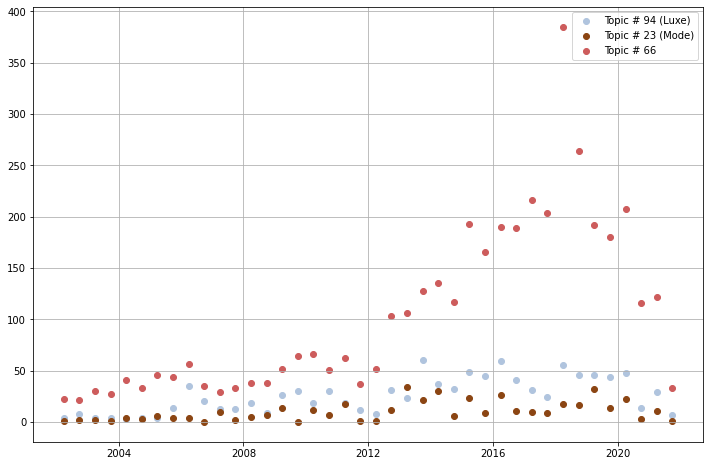

In [61]:
plt.figure(figsize=(12, 8))

topic94 = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']=='Topic # 94'].resample('2BQ').size()
plt.scatter(topic94.index,topic94,color='lightsteelblue',label='Topic # 94 (Luxe)')
    
topic23 = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']=='Topic # 23'].resample('2BQ').size()
plt.scatter(topic23.index,topic23,color='saddlebrown',label='Topic # 23 (Mode)')
 

topic66 = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']=='Topic # 66'].resample('2BQ').size()
plt.scatter(topic66.index,topic66,color='indianred',label='Topic # 66')
    
plt.grid()
plt.legend()
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

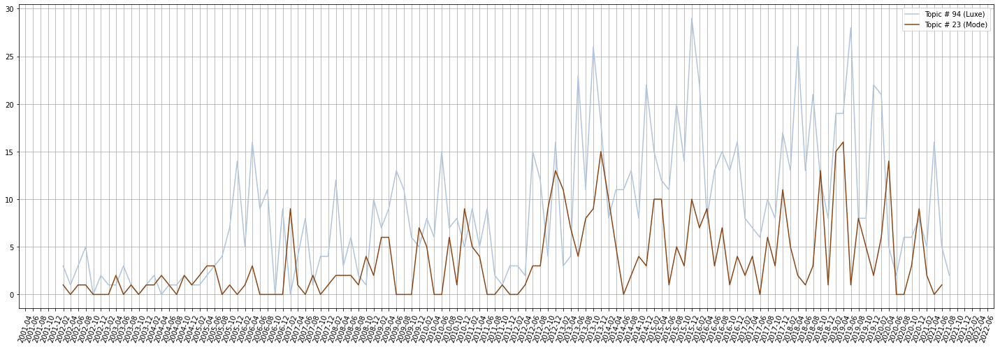

In [63]:
import matplotlib as mpl

plt.figure(figsize=(25, 8))

topic94 = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']=='Topic # 94'].resample('2m').size()
plt.plot(topic94.index,topic94,color='lightsteelblue',label='Topic # 94 (Luxe)')
    
topic23 = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']=='Topic # 23'].resample('2m').size()
plt.plot(topic23.index,topic23,color='saddlebrown',label='Topic # 23 (Mode)')
 
#yearsLoc = mpl.dates.YearLocator()
#plt.gca().xaxis.set_major_locator(yearsLoc)
#monthsLoc = mpl.dates.MonthLocator()
#plt.gca().xaxis.set_major_locator(monthsLoc)
#monthsFmt = mpl.dates.DateFormatter('%b')
#plt.gca().xaxis.set_major_formatter(monthsFmt)
months = mpl.dates.MonthLocator((2,4,6,8,10,12))
plt.gca().xaxis.set_major_locator(months)

plt.xticks(rotation=70)
plt.grid()
plt.legend()
plt.show

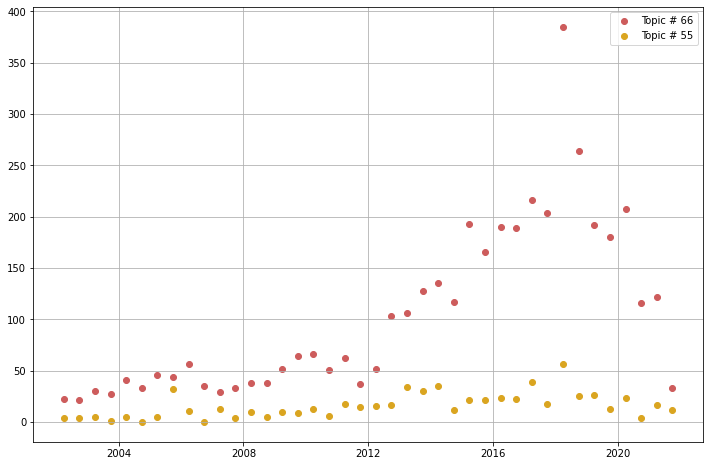

In [65]:
scatter_topic_gene('Topic # 55','goldenrod','2BQ')

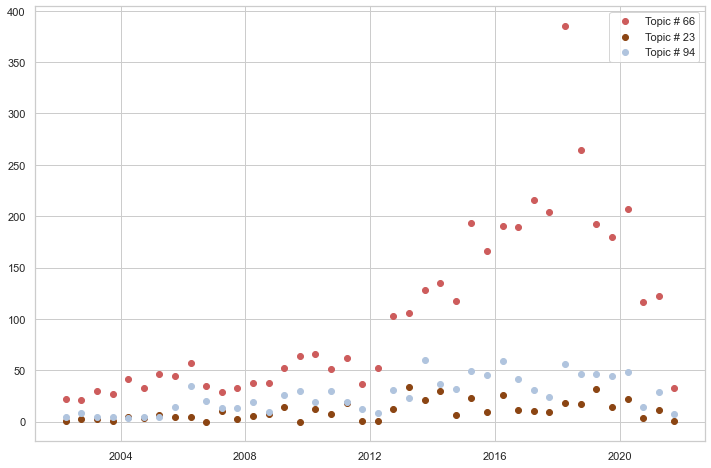

In [414]:
scatter_topic_fashion('Topic # 94','lightsteelblue','2BQ')

<function matplotlib.pyplot.show(close=None, block=None)>

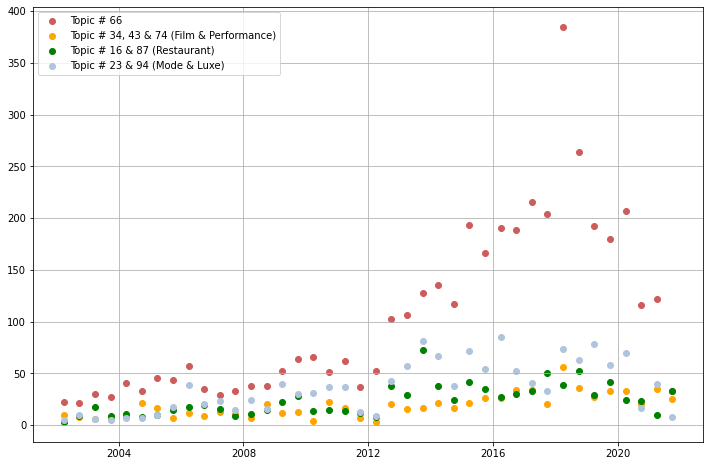

In [66]:

plt.figure(figsize=(12, 8))

topic66 = fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']=='Topic # 66'].resample('2BQ').size()
plt.scatter(topic66.index,topic66,color='indianred',label='Topic # 66')
 

topic_film_performance = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 34') |
                                     (fr_frq_topic['Dominant_Topic']=='Topic # 43') |
                                     (fr_frq_topic['Dominant_Topic']=='Topic # 74')].resample('2BQ').size()
plt.scatter(topic_film_performance.index,topic_film_performance,color='orange',label='Topic # 34, 43 & 74 (Film & Performance)')
    
topic_restau = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 16') |
                                    (fr_frq_topic['Dominant_Topic']=='Topic # 87')].resample('2BQ').size()
plt.scatter(topic_restau.index,topic_restau,color='green',label='Topic # 16 & 87 (Restaurant)')

topic_mode_luxe = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 23') |
                                   (fr_frq_topic['Dominant_Topic']=='Topic # 94')].resample('2BQ').size()
plt.scatter(topic_mode_luxe.index,topic_mode_luxe,color='lightsteelblue',label='Topic # 23 & 94 (Mode & Luxe)')

plt.grid()
plt.legend()
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

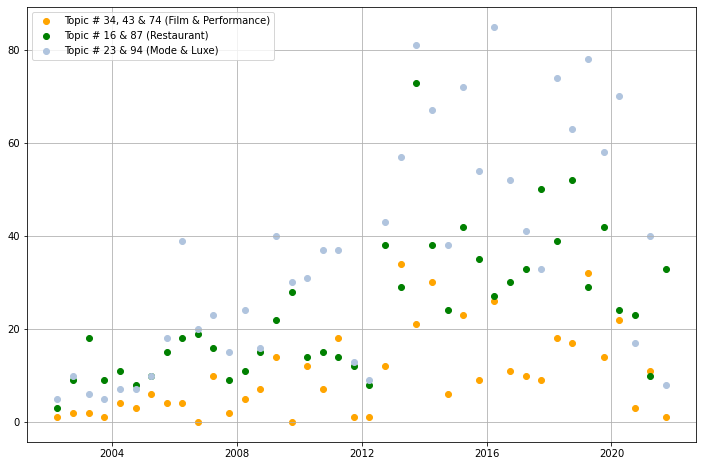

In [67]:

plt.figure(figsize=(12, 8))


    
topic_mode = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 23')].resample('2BQ').size()
plt.scatter(topic_mode.index,topic_mode,color='orange',label='Topic # 34, 43 & 74 (Film & Performance)')
    
topic_restau = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 16') |
                                    (fr_frq_topic['Dominant_Topic']=='Topic # 87')].resample('2BQ').size()
plt.scatter(topic_restau.index,topic_restau,color='green',label='Topic # 16 & 87 (Restaurant)')

topic_mode_luxe = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 23') |
                                   (fr_frq_topic['Dominant_Topic']=='Topic # 94')].resample('2BQ').size()
plt.scatter(topic_mode_luxe.index,topic_mode_luxe,color='lightsteelblue',label='Topic # 23 & 94 (Mode & Luxe)')

plt.grid()
plt.legend()
plt.show

In [421]:
fr_frq_topic.loc[fr_frq_topic['Dominant_Topic']=='Topic # 6'].to_csv('topic6.csv', index=1, header=True)

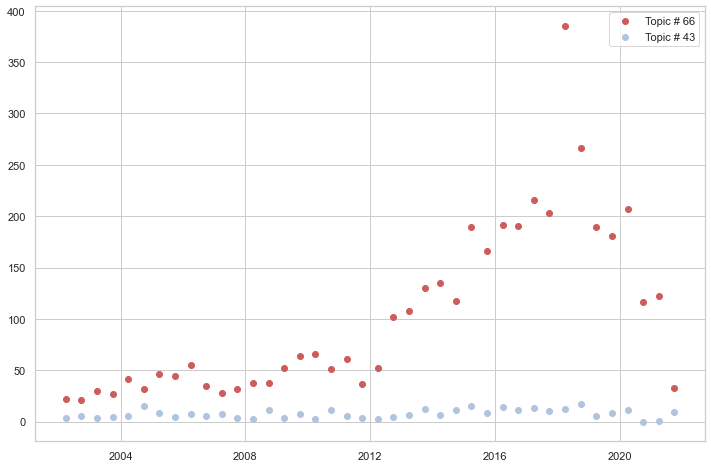

In [1722]:
scatter_topic_restau('Topic # 43','lightsteelblue','2BQ')

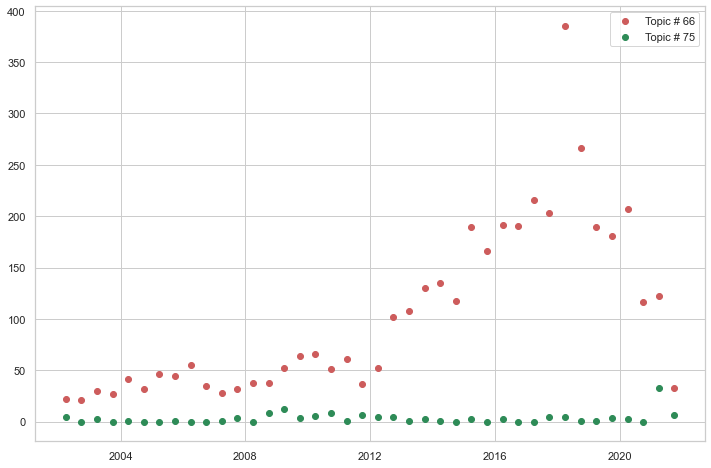

In [1723]:
scatter_topic_gene('Topic # 75','seagreen','2BQ')

In [71]:
ly_cp = cp_sort.resample('q').size()
fig = ly_cp.plot(figsize=(16,12), title='Nombre d\'articles par chaque quarter', c='lightgrey',
               label='Tout',fontsize=20)

cp_fr = cp_sort[cp_sort['Language']=='fr']
ly_cpfr = cp_fr.resample('q').size()
ly_cpfr.plot(figsize=(16,12), title='Nombre d\'articles par trimestre', c='pink',
                 label='Français',fontsize=20)
#plt.scatter(ly_cpfr.index, ly_cpfr, c='pink',label='Français')

cp_en = cp_sort[cp_sort['Language']=='en']
ly_cpen = cp_en.resample('q').size()
ly_cpen.plot(figsize=(16,12), title='Nombre d\'articles par trimestre', c='orange',
                 label='Anglais',fontsize=20)
#plt.scatter(ly_cpen.index, ly_cpen, c='orange',label='Anglais')

plt.grid()
plt.legend(loc=2,fontsize=20)
fig.axes.title.set_size(20)


NameError: name 'cp_sort' is not defined

In [69]:
import matplotlib
import numpy as np
N = 10
base_cmaps = ['tab20','tab20b','tab20c']
n_base = len(base_cmaps)
# we go from 0.2 to 0.8 below to avoid having several whites and blacks in the resulting cmaps
colors = np.concatenate([plt.get_cmap(name)(np.linspace(0.2,0.8,N)) for name in base_cmaps])
cmap = matplotlib.colors.ListedColormap(colors)

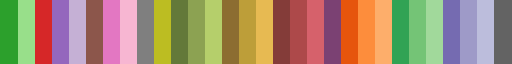

In [70]:
cmap

<AxesSubplot:xlabel='Year'>

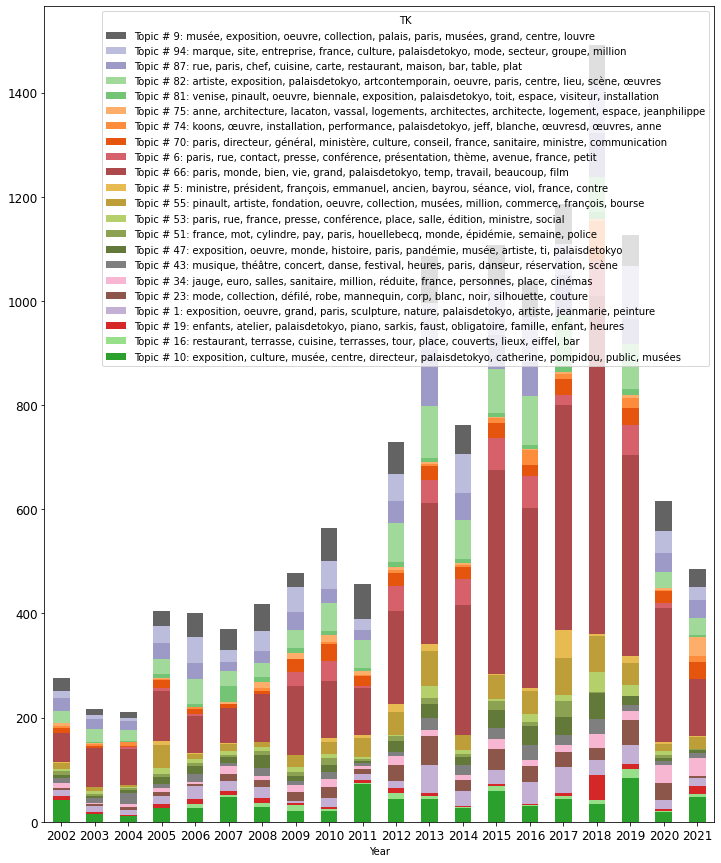

In [72]:
year_topic = fr_frq_topic[['Year', 'TK']]
(year_topic.groupby(['Year', 'TK']).size().unstack('TK')
 .plot.bar(stacked=True, figsize=(12,15),colormap=cmap, fontsize=12, rot=0, legend='reverse'))

In [569]:
#(fr_frq_topic.groupby(['TK']).resample('m').size().unstack('TK')
# .plot.area(stacked=True, figsize=(32,24), fontsize=12, rot=0, colormap=cmap, legend='reverse'))

In [567]:
fr_frq_topic

,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK
Date,,,,,,,,,,,,,
2002-01-26,Le Monde,BREERETTE GENEVIEVE,L'art contemporain dans le déglingué chic des ...,"AVEC SES PLÂTRES lacérés, ses murs de brique e...",fr,4710,2002,170,Topic # 1,0.3259,"exposition, oeuvre, grand, paris, sculpture, n...","[plâtres, lacérés, murs, brique, tuyaux, nu, n...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-02-08,NaN,CAROLINE SALLE,Le musée écrin du sculpteur Bouchard,Le temps s'est arrêté dans l'atelier du sculpt...,fr,4106,2002,190,Topic # 1,0.6571,"exposition, oeuvre, grand, paris, sculpture, n...","[temp, arrêté, atelier, sculpteur, henri, bouc...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-02-11,La Croix,CANITROT ARMELLE,La résistance de Marc Trivier PHOTOGRAPHIE Dou...,"Que devient le photographe Marc Trivier, dont ...",fr,5004,2002,194,Topic # 1,0.4595,"exposition, oeuvre, grand, paris, sculpture, n...","[devient, photographe, marc, trivier, guère, t...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-04-25,Sud Ouest,ALAIN BERNARD,Photo d'un crâneur à Séoul,SAINT-MEDARD D'EXCIDEUIL. Un artiste périgordi...,fr,2183,2002,242,Topic # 1,0.6942,"exposition, oeuvre, grand, paris, sculpture, n...","[saintmedard, excideuil, périgordin, présenter...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-05-03,Sud Ouest,SABINE MENET,Création dynamique,MAI DES ARTS. L'Institution Sainte-Marthe-Sain...,fr,1468,2002,249,Topic # 1,0.3024,"exposition, oeuvre, grand, paris, sculpture, n...","[art, institution, saintemarthesaintfront, ini...","Topic # 1: exposition, oeuvre, grand, paris, s..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-19,Le Parisien,NaN,Où profiter des plus belles terrasses à Paris,Christine Henry C'est le retour des terrasse...,fr,3086,2021,13989,Topic # 94,0.3320,"marque, site, entreprise, france, culture, pal...","[christine, henry, terrasses, longs, fermeture...","Topic # 94: marque, site, entreprise, france, ..."
2021-05-19,Aujourd'hui en France,CHRISTINE HENRY,Réouverture des restaurants notre sélection d...,C'est le retour des terrasses ! Après six long...,fr,8225,2021,13990,Topic # 94,0.2276,"marque, site, entreprise, france, culture, pal...","[terrasses, longs, fermeture, restaurant, rouv...","Topic # 94: marque, site, entreprise, france, ..."
2021-05-23,La Nouvelle République,PBOULBEN,LOISIRS,"Avec le déconfinement de la culture, il y a em...",fr,931,2021,14010,Topic # 94,0.3596,"marque, site, entreprise, france, culture, pal...","[déconfinement, culture, embouteillage, exposi...","Topic # 94: marque, site, entreprise, france, ..."


In [707]:
final_topic = []
t_mode_luxe = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 23') |
                                   (fr_frq_topic['Dominant_Topic']=='Topic # 94')]
t_mode_luxe['FinalTopic'] = 'Mode & Luxe'
t_mode_luxe.to_csv('extracted_topics/t_mode_luxe.csv', index=1, header=True)
t_mode_luxe

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-01-28,NaN,MARTINE HENNO,Vents forts sur la couture,Rien que des classiques et rien que cela chez ...,fr,8436,2002,174,Topic # 23,0.5486,"mode, collection, défilé, robe, mannequin, cor...","[rien, classiques, rien, jeanpaul, gaultier, p...","Topic # 23: mode, collection, défilé, robe, ma...",Mode & Luxe
2002-04-15,Libération,DAHAN ERIC,La Porte de l'Eternité,«Il devait bien y avoir des scientifiques capa...,fr,2980,2002,236,Topic # 23,0.4815,"mode, collection, défilé, robe, mannequin, cor...","[devait, bien, scientifiques, capables, scanne...","Topic # 23: mode, collection, défilé, robe, ma...",Mode & Luxe
2002-06-27,AFP,NaN,Echos des défilés masculins,PARIS (AFP) - Le défilé Daniel Faret parrainé ...,fr,2865,2002,283,Topic # 23,0.1950,"mode, collection, défilé, robe, mannequin, cor...","[paris, afp, défilé, daniel, faret, parrainé, ...","Topic # 23: mode, collection, défilé, robe, ma...",Mode & Luxe
2003-02-16,Le Progres,JOCELYNE VIDAL BLANCHARD,Les créateurs roulent les mécaniques,Habitués à habiller les femmes plutôt que leur...,fr,1791,2003,424,Topic # 23,0.3175,"mode, collection, défilé, robe, mannequin, cor...","[habitués, habiller, femmes, voiture, créateur...","Topic # 23: mode, collection, défilé, robe, ma...",Mode & Luxe
2003-03-13,Libération,"PAQUIN PAQUITA, SAINT ANDRE PERRIN CEDRIC",Défilés qui se défilent,Les temps de crises n'ont jamais été propices ...,fr,3681,2003,434,Topic # 23,0.4206,"mode, collection, défilé, robe, mannequin, cor...","[temp, crisis, jamais, propices, éclosion, nou...","Topic # 23: mode, collection, défilé, robe, ma...",Mode & Luxe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-19,Le Parisien,NaN,Où profiter des plus belles terrasses à Paris,Christine Henry C'est le retour des terrasse...,fr,3086,2021,13989,Topic # 94,0.3320,"marque, site, entreprise, france, culture, pal...","[christine, henry, terrasses, longs, fermeture...","Topic # 94: marque, site, entreprise, france, ...",Mode & Luxe
2021-05-19,Aujourd'hui en France,CHRISTINE HENRY,Réouverture des restaurants notre sélection d...,C'est le retour des terrasses ! Après six long...,fr,8225,2021,13990,Topic # 94,0.2276,"marque, site, entreprise, france, culture, pal...","[terrasses, longs, fermeture, restaurant, rouv...","Topic # 94: marque, site, entreprise, france, ...",Mode & Luxe
2021-05-23,La Nouvelle République,PBOULBEN,LOISIRS,"Avec le déconfinement de la culture, il y a em...",fr,931,2021,14010,Topic # 94,0.3596,"marque, site, entreprise, france, culture, pal...","[déconfinement, culture, embouteillage, exposi...","Topic # 94: marque, site, entreprise, france, ...",Mode & Luxe


In [708]:
t_restau = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 16') |
                                   (fr_frq_topic['Dominant_Topic']=='Topic # 87')]
t_restau['FinalTopic'] = 'Cuisine & Restaurant'
t_restau.to_csv('extracted_topics/t_restau.csv', index=1, header=True)
t_restau

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-04-04,Le Parisien,NICOLAS DELACOUR,Invitez vous au palais,*RESTAURANT. Fini les courbettes : aujourd'hui...,fr,1244,2002,229,Topic # 16,0.2472,"restaurant, terrasse, cuisine, terrasses, tour...","[restaurant, fini, courbettes, palaisdetokyo, ...","Topic # 16: restaurant, terrasse, cuisine, ter...",Cuisine & Restaurant
2006-02-02,L'Express,LA CASINIÈRE NICOLAS DE,Rendez vous branchés,"3, allée Flesselles, 02-40-47-66-14. Le Lieu u...",fr,1632,2006,1373,Topic # 16,0.6683,"restaurant, terrasse, cuisine, terrasses, tour...","[allée, flesselles, lieu, unique, décor, ancie...","Topic # 16: restaurant, terrasse, cuisine, ter...",Cuisine & Restaurant
2006-06-24,Télérama,SOPHIE BERTHIER,Mon vert Paris,"Paris terre d'accueil pour les hérons, les ren...",fr,1432,2006,1545,Topic # 16,0.1959,"restaurant, terrasse, cuisine, terrasses, tour...","[paris, terre, accueil, hérons, renards, plant...","Topic # 16: restaurant, terrasse, cuisine, ter...",Cuisine & Restaurant
2006-06-24,Le Parisien,MARIE LINTON,La nature s'invite à Paris,"L'ÉTÉ EST LÀ, la nature exulte. Ce week-end, l...",fr,3111,2006,1546,Topic # 16,0.2060,"restaurant, terrasse, cuisine, terrasses, tour...","[nature, exulte, weekend, jardin, acclimatatio...","Topic # 16: restaurant, terrasse, cuisine, ter...",Cuisine & Restaurant
2006-08-03,SNC EParis,MARIE EMMANUELLE GALFRÉ,La terrasse du musée d'Art moderne,"AVEC les beaux jours, le café du musée d'Art m...",fr,1237,2006,1590,Topic # 16,0.4551,"restaurant, terrasse, cuisine, terrasses, tour...","[beau, jours, café, musée, artModerne, sort, m...","Topic # 16: restaurant, terrasse, cuisine, ter...",Cuisine & Restaurant
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-06-09,Le Progres,NaN,Le chef étoilé Mory Sacko ouvre sa terrasse ép...,"C'est une adresse très attendue à Lyon : Edo, ...",fr,1320,2021,14079,Topic # 87,0.7392,"rue, paris, chef, cuisine, carte, restaurant, ...","[adresse, attendue, lyon, edo, restaurant, éph...","Topic # 87: rue, paris, chef, cuisine, carte, ...",Cuisine & Restaurant
2021-06-09,20 Minutes,NaN,"Mory Sacko « Les chefs gastronomiques, on a t...",INTERVIEW Ancien candidat du concours « Top ...,fr,7356,2021,14081,Topic # 87,0.7305,"rue, paris, chef, cuisine, carte, restaurant, ...","[interview, ancien, candidat, concours, chef, ...","Topic # 87: rue, paris, chef, cuisine, carte, ...",Cuisine & Restaurant
2021-06-09,20 Minutes,CAROLINE GIRARDON,"« À Lyon, j'ai vu des gens qui aiment vraiment...",MORY SACKO Plus de 4 000 réservations en vin...,fr,2673,2021,14084,Topic # 87,0.4861,"rue, paris, chef, cuisine, carte, restaurant, ...","[mory, sacko, réservations, vingtquatre, heure...","Topic # 87: rue, paris, chef, cuisine, carte, ...",Cuisine & Restaurant


In [709]:
t_ef = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 43') |
                                   (fr_frq_topic['Dominant_Topic']=='Topic # 74')|
                                   (fr_frq_topic['Dominant_Topic']=='Topic # 81')]
t_ef['FinalTopic'] = 'Événements & Festivals'
t_ef.to_csv('extracted_topics/t_ef.csv', index=1, header=True)
t_ef

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-01-21,Le Monde,NaN,Les premiers jours du Palais de Tokyo,"Palais de Tokyo, site de création contemporain...",fr,2301,2002,123,Topic # 43,0.2193,"musique, théâtre, concert, danse, festival, he...","[palaisdetokyo, site, création, contemporaine,...","Topic # 43: musique, théâtre, concert, danse, ...",Événements & Festivals
2002-01-22,Libération,BINET STÉPHANIE,Bauchklang au palais,"Révélation des Transmusicales 2001, Bauchklang...",fr,639,2002,156,Topic # 43,0.3980,"musique, théâtre, concert, danse, festival, he...","[révélation, transmusicales, bauchklang, group...","Topic # 43: musique, théâtre, concert, danse, ...",Événements & Festivals
2002-02-13,NaN,SOPHIE DE SANTIS,House au musée,Les grandes métropoles ne s'arrêtent pas de vi...,fr,1541,2002,196,Topic # 43,0.5605,"musique, théâtre, concert, danse, festival, he...","[grandes, métropoles, arrêtent, vivre, nuit, a...","Topic # 43: musique, théâtre, concert, danse, ...",Événements & Festivals
2002-04-03,Le Monde,NaN,LES GENS DU MONDE,"Le prix La ville à lire, créé en 1996 par Fran...",fr,2579,2002,228,Topic # 43,0.1923,"musique, théâtre, concert, danse, festival, he...","[prix, ville, lira, créé, franceculture, revue...","Topic # 43: musique, théâtre, concert, danse, ...",Événements & Festivals
2002-04-06,Libération,BERNIER ALEXIS,Sculpture de sons,"Conçue comme un prolongement de l'Audiolab, ce...",fr,768,2002,231,Topic # 43,0.2444,"musique, théâtre, concert, danse, festival, he...","[conçue, prolongement, audiolab, installation,...","Topic # 43: musique, théâtre, concert, danse, ...",Événements & Festivals
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-09-20,Ouest France,XAVIER ORIOT,Normandie Les Énervés de Jumièges d’Ange Leccia,Au rez-de-chaussée et à l’étage du logis abbat...,fr,2579,2019,12594,Topic # 81,0.2035,"venise, pinault, oeuvre, biennale, exposition,...","[rezdechaussée, étage, logis, abbatial, écrans...","Topic # 81: venise, pinault, oeuvre, biennale,...",Événements & Festivals
2019-09-20,L'Orient Le Jour,ZÉNA ZALZAL,Un musée pour les dix ans de la Beirut Art Fair,Événement Pour passer le cap de sa première dé...,fr,10193,2019,12595,Topic # 81,0.2300,"venise, pinault, oeuvre, biennale, exposition,...","[événement, passer, cap, décennie, beauté, foi...","Topic # 81: venise, pinault, oeuvre, biennale,...",Événements & Festivals
2021-05-17,Editions Lafitte Hébrard SAS,NaN,Profil Laurent Dumas,"Prénom: Laurent Autre(s) prénom (s): Laurent, ...",fr,1781,2021,13978,Topic # 81,0.1946,"venise, pinault, oeuvre, biennale, exposition,...","[prénom, laurent, prénom, laurent, serge, alai...","Topic # 81: venise, pinault, oeuvre, biennale,...",Événements & Festivals


In [710]:
t_exp_oeu = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 1') |
                                   (fr_frq_topic['Dominant_Topic']=='Topic # 47')]
t_exp_oeu['FinalTopic'] = 'Expositions & Œuvres'
t_exp_oeu.to_csv('extracted_topics/t_exp_oeu.csv', index=1, header=True)
t_exp_oeu

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-01-26,Le Monde,BREERETTE GENEVIEVE,L'art contemporain dans le déglingué chic des ...,"AVEC SES PLÂTRES lacérés, ses murs de brique e...",fr,4710,2002,170,Topic # 1,0.3259,"exposition, oeuvre, grand, paris, sculpture, n...","[plâtres, lacérés, murs, brique, tuyaux, nu, n...","Topic # 1: exposition, oeuvre, grand, paris, s...",Expositions & Œuvres
2002-02-08,NaN,CAROLINE SALLE,Le musée écrin du sculpteur Bouchard,Le temps s'est arrêté dans l'atelier du sculpt...,fr,4106,2002,190,Topic # 1,0.6571,"exposition, oeuvre, grand, paris, sculpture, n...","[temp, arrêté, atelier, sculpteur, henri, bouc...","Topic # 1: exposition, oeuvre, grand, paris, s...",Expositions & Œuvres
2002-02-11,La Croix,CANITROT ARMELLE,La résistance de Marc Trivier PHOTOGRAPHIE Dou...,"Que devient le photographe Marc Trivier, dont ...",fr,5004,2002,194,Topic # 1,0.4595,"exposition, oeuvre, grand, paris, sculpture, n...","[devient, photographe, marc, trivier, guère, t...","Topic # 1: exposition, oeuvre, grand, paris, s...",Expositions & Œuvres
2002-04-25,Sud Ouest,ALAIN BERNARD,Photo d'un crâneur à Séoul,SAINT-MEDARD D'EXCIDEUIL. Un artiste périgordi...,fr,2183,2002,242,Topic # 1,0.6942,"exposition, oeuvre, grand, paris, sculpture, n...","[saintmedard, excideuil, périgordin, présenter...","Topic # 1: exposition, oeuvre, grand, paris, s...",Expositions & Œuvres
2002-05-03,Sud Ouest,SABINE MENET,Création dynamique,MAI DES ARTS. L'Institution Sainte-Marthe-Sain...,fr,1468,2002,249,Topic # 1,0.3024,"exposition, oeuvre, grand, paris, sculpture, n...","[art, institution, saintemarthesaintfront, ini...","Topic # 1: exposition, oeuvre, grand, paris, s...",Expositions & Œuvres
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-01,Tribune de Genève,NaN,[Créatives],Créatives Genre Décoder l'art Littératur...,fr,13545,2020,13544,Topic # 47,0.3174,"exposition, oeuvre, monde, histoire, paris, pa...","[créatives, genre, décoder, littérature, docum...","Topic # 47: exposition, oeuvre, monde, histoir...",Expositions & Œuvres
2021-02-06,SCIC Nice Matin,NaN,43 détenus vaccinés en prison,de Sceaux Eric Dupond-Moretti sur France info....,fr,6146,2021,13672,Topic # 47,0.2489,"exposition, oeuvre, monde, histoire, paris, pa...","[sceaux, eric, dupondmoretti, france, info, dé...","Topic # 47: exposition, oeuvre, monde, histoir...",Expositions & Œuvres
2021-03-20,L'Est Républicain,NaN,Les colombes en papier des enfants iront au Pa...,Plusieurs classes de l’école Bourlier qui déco...,fr,1989,2021,13864,Topic # 47,0.3850,"exposition, oeuvre, monde, histoire, paris, pa...","[class, école, bourlier, découvrent, travers, ...","Topic # 47: exposition, oeuvre, monde, histoir...",Expositions & Œuvres


In [711]:
t_exp_instit = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 10') |
                                   (fr_frq_topic['Dominant_Topic']=='Topic # 9')]
t_exp_instit['FinalTopic'] = 'Expositions & Autres instituions'
t_exp_instit.to_csv('extracted_topics/t_exp_instit.csv', index=1, header=True)
t_exp_instit

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-01-21,AFP,ANNICK BENOIST,"Au Palais de Tokyo, poubelle à infos et marché...",PARIS (AFP) - Une gigantesque poubelle à infos...,fr,2477,2002,117,Topic # 9,0.3410,"musée, exposition, oeuvre, collection, palais,...","[paris, afp, gigantesque, poubelle, info, marc...","Topic # 9: musée, exposition, oeuvre, collecti...",Expositions & Autres instituions
2002-01-21,Libération,GAUVILLE HERVÉ; LEBOVICI ELISABETH,A voir et à manger,C'est donc un chantier destiné à le rester. L'...,fr,4752,2002,128,Topic # 9,0.4562,"musée, exposition, oeuvre, collection, palais,...","[chantier, destiné, rester, architecture, pala...","Topic # 9: musée, exposition, oeuvre, collecti...",Expositions & Autres instituions
2002-01-21,Libération,DEBAILLEUX HENRI FRANÇOIS,De l'Exposition internationale de 1937 à nos j...,Pourquoi s'appelle-t-il le Palais de Tokyo? Le...,fr,2887,2002,141,Topic # 9,0.3378,"musée, exposition, oeuvre, collection, palais,...","[appelletil, palaisdetokyo, bâtiment, tire, no...","Topic # 9: musée, exposition, oeuvre, collecti...",Expositions & Autres instituions
2002-01-21,Libération,NaN,Glossaire,Quelques mots indispensables pour parler la la...,fr,1965,2002,143,Topic # 9,0.5024,"musée, exposition, oeuvre, collection, palais,...","[mot, indispensables, langue, usage, familiers...","Topic # 9: musée, exposition, oeuvre, collecti...",Expositions & Autres instituions
2002-01-30,NaN,HERVÉ GUENOT,Une vague de critiques submerge le Musée d'art...,La droite estime en effet que le département n...,fr,2178,2002,178,Topic # 9,0.5258,"musée, exposition, oeuvre, collection, palais,...","[droite, estime, département, moyens, ambition...","Topic # 9: musée, exposition, oeuvre, collecti...",Expositions & Autres instituions
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-06-02,Economy L'Echo,NaN,Nos bonnes adresses gourmandes à Paris,Où sert-on une cuisine authentique à Paris? Qu...,fr,278,2021,14049,Topic # 10,0.3731,"exposition, culture, musée, centre, directeur,...","[serton, cuisine, authentique, paris, chef, co...","Topic # 10: exposition, culture, musée, centre...",Expositions & Autres instituions
2021-06-03,Ouest France,AGNÈS LE MORVAN,Une statue monumentale sur le parvis de la Gare,"Pour la station Gares du métro, Jean-Marie App...",fr,3014,2021,14052,Topic # 10,0.4358,"exposition, culture, musée, centre, directeur,...","[station, gares, métro, jeanmarie, appriou, ré...","Topic # 10: exposition, culture, musée, centre...",Expositions & Autres instituions
2021-06-04,Le Figaro,CLÉMENCE BALLANDRAS,"Colline de Chaillot, «un projet rêvé depuis lo...",«C'est une initiative qui a été prise en commu...,fr,4620,2021,14061,Topic # 10,0.3861,"exposition, culture, musée, centre, directeur,...","[initiative, prise, commun, directeurs, instit...","Topic # 10: exposition, culture, musée, centre...",Expositions & Autres instituions


In [712]:
t_archi = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 75')]
t_archi['FinalTopic'] = 'Architecture'
t_archi.to_csv('extracted_topics/t_archi.csv', index=1, header=True)
t_archi

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-01-05,l'Humanité,NaN,La cité manifeste ou le logement autrement,"En 1853, des industriels de la haute société p...",fr,6460,2002,92,Topic # 75,0.2636,"anne, architecture, lacaton, vassal, logements...","[industriels, haute, société, protestante, mul...","Topic # 75: anne, architecture, lacaton, vassa...",Architecture
2002-01-17,L'Express,COLONNA CÉSARI ANNICK,Deux architectes minimalistes,L'aménagement du Site de création contemporain...,fr,1652,2002,100,Topic # 75,0.4007,"anne, architecture, lacaton, vassal, logements...","[aménagement, site, création, contemporaine, s...","Topic # 75: anne, architecture, lacaton, vassa...",Architecture
2002-01-21,Le Monde,CHAMPENOIS MICHELE,"Le Palais de Tokyo, de 1937 à demain","S'INSTALLER durablement dans l'éphémère, c'est...",fr,3033,2002,127,Topic # 75,0.3002,"anne, architecture, lacaton, vassal, logements...","[installer, durablement, éphémère, doute, arri...","Topic # 75: anne, architecture, lacaton, vassa...",Architecture
2002-01-22,l'Humanité,NaN,Une architecture dédiée à l'espace et à l'esprit,Si Anne Lacaton et Jean-Philippe Vassal ont re...,fr,3427,2002,150,Topic # 75,0.2867,"anne, architecture, lacaton, vassal, logements...","[anne, lacaton, jeanphilippe, vassal, remporté...","Topic # 75: anne, architecture, lacaton, vassa...",Architecture
2002-10-27,Sud Ouest,DOMINIQUE GODFREY,Lacaton et Vassal comme chez eux,Architecture. Arc-en-rêve consacre une rétrosp...,fr,2626,2002,349,Topic # 75,0.3707,"anne, architecture, lacaton, vassal, logements...","[architecture, arcenrêve, consacre, rétrospect...","Topic # 75: anne, architecture, lacaton, vassa...",Architecture
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-13,NV Roularta Media Group,NaN,3 questions À Romain Costa,TD Formé à Saint-Luc et désormais basé à Paris...,fr,2312,2021,13965,Topic # 75,0.5515,"anne, architecture, lacaton, vassal, logements...","[td, formé, saintluc, basé, paris, exerce, arc...","Topic # 75: anne, architecture, lacaton, vassa...",Architecture
2021-05-27,Economy Capital FR,NaN,Où se sont rendus les Franciliens après le déc...,Après des semaines de ralentissement de l'acti...,fr,276,2021,14028,Topic # 75,0.4012,"anne, architecture, lacaton, vassal, logements...","[semaines, ralentissement, activité, chauffeur...","Topic # 75: anne, architecture, lacaton, vassa...",Architecture
2021-05-27,Le Progres,DT,Une terrasse éphémère dès le 9 juin sur l'espl...,Après une première en 2020 sur le parvis du Pa...,fr,1788,2021,14029,Topic # 75,0.4225,"anne, architecture, lacaton, vassal, logements...","[parvis, palaisdetokyo, vue, imprenable, tour,...","Topic # 75: anne, architecture, lacaton, vassa...",Architecture


In [713]:
t_fondation = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 55')]
t_fondation['FinalTopic'] = 'Fondations & Collectionneurs'
t_fondation.to_csv('extracted_topics/t_fondation.csv', index=1, header=True)
t_fondation

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-01-18,Libération,MASI BRUNO,L'art sur un plateau,Ce serait presque un conte de fées: une petite...,fr,4360,2002,107,Topic # 55,0.2796,"pinault, artiste, fondation, oeuvre, collectio...","[presque, conte, fées, petite, association, qu...","Topic # 55: pinault, artiste, fondation, oeuvr...",Fondations & Collectionneurs
2002-01-21,Le Monde,BELLET HARRY; CHAMPENOIS MICHELE,Catherine Tasca ministre de la culture et de l...,"Au moment où s'ouvre le Palais de Tokyo, pouve...",fr,6258,2002,138,Topic # 55,0.5748,"pinault, artiste, fondation, oeuvre, collectio...","[moment, ouvre, palaisdetokyo, pouvezvous, déf...","Topic # 55: pinault, artiste, fondation, oeuvr...",Fondations & Collectionneurs
2002-01-22,NaN,NaN,Paris revient au premier plan après 40 ans d'é...,Il s'agit de structures qui disposent d'une gr...,fr,1368,2002,161,Topic # 55,0.6181,"pinault, artiste, fondation, oeuvre, collectio...","[agit, structure, disposent, grande, autonomie...","Topic # 55: pinault, artiste, fondation, oeuvr...",Fondations & Collectionneurs
2002-02-07,NaN,NaN,"Miroir, dis moi que je suis la plus belle",MARIO D'ANGELO Chaque mois apporte son illustr...,fr,5843,2002,188,Topic # 55,0.4400,"pinault, artiste, fondation, oeuvre, collectio...","[mario, angelo, apporte, illustration, engouem...","Topic # 55: pinault, artiste, fondation, oeuvr...",Fondations & Collectionneurs
2002-04-12,Le Point,PHILIPPE DAGEN,La gazette des châteaux,"Pendant deux semaines, dans la rubrique « Idée...",fr,6164,2002,235,Topic # 55,0.4534,"pinault, artiste, fondation, oeuvre, collectio...","[semaines, rubrique, idées, académicien, marc,...","Topic # 55: pinault, artiste, fondation, oeuvr...",Fondations & Collectionneurs
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-21,La Matinale du Monde,ROXANA AZIMI,"Catherine Millet, une libertine envers et cont...","Le visage est celui d'un sphinx. Le sourire, i...",fr,28681,2021,14002,Topic # 55,0.3334,"pinault, artiste, fondation, oeuvre, collectio...","[visage, sphinx, sourire, imperturbable, peine...","Topic # 55: pinault, artiste, fondation, oeuvr...",Fondations & Collectionneurs
2021-05-26,Lifestyle Sortir à Paris,NaN,"Bambini, la nouvelle cantine italienne du Pala...",Par Manon C. · Publié le 26 mai 2021 à 22h53 ·...,fr,231,2021,14016,Topic # 55,0.3399,"pinault, artiste, fondation, oeuvre, collectio...","[manon, publié, mi, jour, dolce, vita, invite,...","Topic # 55: pinault, artiste, fondation, oeuvr...",Fondations & Collectionneurs
2021-05-26,Information Technology & Internet Le Progres,NaN,Lyon Une terrasse éphémère s’installe dès le 9...,Lyon Une terrasse éphémère s’installe dès le 9...,fr,256,2021,14021,Topic # 55,0.4668,"pinault, artiste, fondation, oeuvre, collectio...","[lyon, terrasse, éphémère, installe, esplanade...","Topic # 55: pinault, artiste, fondation, oeuvr...",Fondations & Collectionneurs


In [714]:
t_cine = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 34')]
t_cine['FinalTopic'] = 'Cinéma'
t_cine.to_csv('extracted_topics/t_cine.csv', index=1, header=True)
t_cine

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-01-15,AFP,NaN,Un musée d'art contemporain au sud de Paris fi...,VITRY-SUR-SEINE (Val-de-Marne) (AFP) - Un musé...,fr,1445,2002,95,Topic # 34,0.4145,"jauge, euro, salles, sanitaire, million, rédui...","[vitrysurseine, valdemarne, afp, musée, artcon...","Topic # 34: jauge, euro, salles, sanitaire, mi...",Cinéma
2002-01-15,AFP,NaN,Un nouveau musée d'art contemporain au sud de ...,VITRY-SUR-SEINE (France) (AFP) - Un musée d'ar...,fr,1532,2002,96,Topic # 34,0.3800,"jauge, euro, salles, sanitaire, million, rédui...","[vitrysurseine, france, afp, musée, artcontemp...","Topic # 34: jauge, euro, salles, sanitaire, mi...",Cinéma
2002-01-16,Le Devoir,NaN,Un nouveau musée à Paris,Vitry-Sur-Seine - Un musée d'art contemporain ...,fr,1491,2002,99,Topic # 34,0.3928,"jauge, euro, salles, sanitaire, million, rédui...","[vitrysurseine, musée, artcontemporain, ouvrir...","Topic # 34: jauge, euro, salles, sanitaire, mi...",Cinéma
2002-01-21,NaN,NaN,Voici la chronique ARTS ET SPECTACLES CR CP,Moulin Rouge et Un homme d'exception sont réco...,fr,8069,2002,142,Topic # 34,0.2183,"jauge, euro, salles, sanitaire, million, rédui...","[moulin, rouge, homme, exception, récompensés,...","Topic # 34: jauge, euro, salles, sanitaire, mi...",Cinéma
2002-02-13,NaN,NaN,KALÈIDOSCOPE,EN PLEIN DANS LE PANNEAU RETOUR À LA CASE DÉPA...,fr,3212,2002,197,Topic # 34,0.2165,"jauge, euro, salles, sanitaire, million, rédui...","[plein, panneau, case, départ, prochain, coupo...","Topic # 34: jauge, euro, salles, sanitaire, mi...",Cinéma
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-25,Société Générale de Presse et d'Edition SAL,NaN,La scénographie du Pavillon libanais dévoilée ...,Cette cérémonie officielle s’est déroulée en p...,fr,9487,2021,14015,Topic # 34,0.2148,"jauge, euro, salles, sanitaire, million, rédui...","[cérémonie, officielle, déroulée, présence, ce...","Topic # 34: jauge, euro, salles, sanitaire, mi...",Cinéma
2021-05-26,IPM S.A.,RPT RPT RPT G DT G DT G DT GW G GW G,Nos choix étoilés,Nicolas Delprat – Stage Two Où Michèle Schoonj...,fr,3113,2021,14018,Topic # 34,0.5725,"jauge, euro, salles, sanitaire, million, rédui...","[nicolas, delprat, stage, michèle, schoonjans,...","Topic # 34: jauge, euro, salles, sanitaire, mi...",Cinéma
2021-05-31,La Libre Belgique,NaN,Elles ont fait l'histoire de l'art mais furent...,Guy Duplat Envoyé spécial à Paris Cent six a...,fr,4449,2021,14041,Topic # 34,0.4927,"jauge, euro, salles, sanitaire, million, rédui...","[guy, duplat, envoyé, spécial, paris, artiste,...","Topic # 34: jauge, euro, salles, sanitaire, mi...",Cinéma


In [715]:
t_ate = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 19')]
t_ate['FinalTopic'] = 'Atelier'
t_ate.to_csv('extracted_topics/t_ate.csv', index=1, header=True)
t_ate

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-02-06,Le Parisien,LAURA MOUDELAUD,Des ateliers sur mesure au palais de Tokyo,*ENFANTS. Rien d'étonnant à ce que le palais d...,fr,1344,2002,186,Topic # 19,0.7444,"enfants, atelier, palaisdetokyo, piano, sarkis...","[enfants, rien, étonnant, palaisdetokyo, veut,...","Topic # 19: enfants, atelier, palaisdetokyo, p...",Atelier
2002-02-24,Le Parisien,LAURA MOUDELAUD,Art contemporain au Palais de Tokyo,"A VEC 1 800 VISITEURS en moyenne chaque jour, ...",fr,1691,2002,208,Topic # 19,0.3193,"enfants, atelier, palaisdetokyo, piano, sarkis...","[vec, visiteurs, moyenne, jour, palaisdetokyo,...","Topic # 19: enfants, atelier, palaisdetokyo, p...",Atelier
2002-03-12,Libération,MARCELLE PIERRE,Saloperie d'hirondelle,"C'est le printemps ­ le ciel dit ça, et la dou...",fr,2140,2002,220,Topic # 19,0.6138,"enfants, atelier, palaisdetokyo, piano, sarkis...","[printemps, ­, ciel, douceur, air, brumeux, hu...","Topic # 19: enfants, atelier, palaisdetokyo, p...",Atelier
2002-08-02,Le Parisien,NaN,"Wolfang Tillmans, au Palais de Tokyo Pour l'ex...","TOUS LES JOURS, SAUF LUNDI , DE 12 HEURES A MI...",fr,340,2002,297,Topic # 19,0.6555,"enfants, atelier, palaisdetokyo, piano, sarkis...","[jours, heures, minuit, palaisdetokyo, avenued...","Topic # 19: enfants, atelier, palaisdetokyo, p...",Atelier
2002-08-17,Le Parisien,ND,Culture en nocturne au palais de Tokyo,OUVERT DU MARDI AU DIMANCHE DE MIDI A MINUIT ...,fr,208,2002,304,Topic # 19,0.3697,"enfants, atelier, palaisdetokyo, piano, sarkis...","[midi, minuit, palaisdetokyo, av, pstwilson, x...","Topic # 19: enfants, atelier, palaisdetokyo, p...",Atelier
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-03-05,Le Figaro,"VALÉRIE DUPONCHELLE, BÉATRICE DE ROCHEBOUËT","Découvertes, premières ventes et déceptions n...","Créé en collaboration avec Artlogic, leader en...",fr,10289,2021,13814,Topic # 19,0.2615,"enfants, atelier, palaisdetokyo, piano, sarkis...","[créé, collaboration, artlogic, leader, techno...","Topic # 19: enfants, atelier, palaisdetokyo, p...",Atelier
2021-03-08,Editions Lafitte Hébrard SAS,NaN,Profil Bruno Peinado,"Autre(s) prénom (s): (Bruno, Pierre) Civilité:...",fr,2357,2021,13816,Topic # 19,0.2060,"enfants, atelier, palaisdetokyo, piano, sarkis...","[prénom, bruno, pierre, civilité, monsieur, co...","Topic # 19: enfants, atelier, palaisdetokyo, p...",Atelier
2021-03-20,Flaner Bouger,NaN,Les Trois Châteaux Paris 11ème Arrondissement...,Rakajoo (alias Baye-Dam Cissé) est un jeune ar...,fr,1460,2021,13862,Topic # 19,0.8762,"enfants, atelier, palaisdetokyo, piano, sarkis...","[rakajoo, alias, bayedam, cissé, jeune, frança...","Topic # 19: enfants, atelier, palaisdetokyo, p...",Atelier


In [716]:
t_gene = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 66')]
t_gene['FinalTopic'] = 'Descriptions générales'
t_gene.to_csv('extracted_topics/t_gene.csv', index=1, header=True)
t_gene

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-01-17,L'Express,COLONNA CÉSARI ANNICK,Les nouveaux lieux de l'art contemporain,"A Paris, le palais de Tokyo rouvre ses portes ...",fr,6603,2002,101,Topic # 66,0.2658,"paris, monde, bien, vie, grand, palaisdetokyo,...","[paris, palaisdetokyo, rouvre, porte, mètres, ...","Topic # 66: paris, monde, bien, vie, grand, pa...",Descriptions générales
2002-01-18,NaN,NaN,CETTE SEMAINE Le 19 janvier,Suites de Bach en impair La Bible des violonce...,fr,3287,2002,104,Topic # 66,0.3113,"paris, monde, bien, vie, grand, palaisdetokyo,...","[suite, bach, impair, bible, violoncellistes, ...","Topic # 66: paris, monde, bien, vie, grand, pa...",Descriptions générales
2002-01-21,AFP,NaN,,PARIS (AFP) - Voici l'agenda du lundi 21 janvi...,fr,6764,2002,119,Topic # 66,0.2536,"paris, monde, bien, vie, grand, palaisdetokyo,...","[paris, afp, agenda, europe, horaire, exact, é...","Topic # 66: paris, monde, bien, vie, grand, pa...",Descriptions générales
2002-01-21,AFP,ANNICK BENOIST,"Au palais labo de Tokyo, poubelle à infos et m...",PARIS (AFP) - Une gigantesque poubelle à infos...,fr,2648,2002,126,Topic # 66,0.3633,"paris, monde, bien, vie, grand, palaisdetokyo,...","[paris, afp, gigantesque, poubelle, info, marc...","Topic # 66: paris, monde, bien, vie, grand, pa...",Descriptions générales
2002-01-21,NaN,NaN,RESUME DE L'ACTUALITE A 1700 GMT (21/01),"L'Union européenne, le Japon, l'Arabie saoudit...",fr,6428,2002,139,Topic # 66,0.2374,"paris, monde, bien, vie, grand, palaisdetokyo,...","[union, européenne, japon, arabie, saoudite, e...","Topic # 66: paris, monde, bien, vie, grand, pa...",Descriptions générales
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-28,Le Figaro,ALICE BOSIO,Bambini contre Forest duel en terrasse sur la ...,"Deux terrasses, deux ambiances. En ce printemp...",fr,5594,2021,14033,Topic # 66,0.4456,"paris, monde, bien, vie, grand, palaisdetokyo,...","[terrasses, ambiance, printemps, particulier, ...","Topic # 66: paris, monde, bien, vie, grand, pa...",Descriptions générales
2021-05-31,L'Est Républicain,NaN,Besançon ; Bien Urbain fête (enfin)ses dix ans...,De nombreux artistes présents cette année sont...,fr,2134,2021,14045,Topic # 66,0.5212,"paris, monde, bien, vie, grand, palaisdetokyo,...","[artiste, présents, année, habitués, ca, exemp...","Topic # 66: paris, monde, bien, vie, grand, pa...",Descriptions générales
2021-06-08,Information Technology & Internet Le Progres,NaN,Lyon Le Top chef étoilé Mory Sacko ouvre mercr...,Lyon Le Top chef étoilé Mory Sacko ouvre mercr...,fr,267,2021,14078,Topic # 66,0.3864,"paris, monde, bien, vie, grand, palaisdetokyo,...","[lyon, chef, étoilé, mory, sacko, ouvre, terra...","Topic # 66: paris, monde, bien, vie, grand, pa...",Descriptions générales


In [717]:
t_artiste = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 82')]
t_artiste['FinalTopic'] = 'Artistes, Expositions & Art contemporain'
t_artiste.to_csv('extracted_topics/t_artiste.csv', index=1, header=True)
t_artiste

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-01-11,NaN,JUDITH BENHAMOU HUET,Révolution de palais,Le 21 janvier prochain à Paris sera inauguré l...,fr,6280,2002,93,Topic # 82,0.4012,"artiste, exposition, palaisdetokyo, artcontemp...","[prochain, paris, inauguré, palaisdetokyo, sit...","Topic # 82: artiste, exposition, palaisdetokyo...","Artistes, Expositions & Art contemporain"
2002-01-11,AFP,NaN,Le Site de création contemporaine de Paris ina...,PARIS (AFP) - Le Site de création contemporain...,fr,1802,2002,94,Topic # 82,0.5156,"artiste, exposition, palaisdetokyo, artcontemp...","[paris, afp, site, création, contemporaine, vé...","Topic # 82: artiste, exposition, palaisdetokyo...","Artistes, Expositions & Art contemporain"
2002-01-18,Le Figaro,MICHEL NURIDSANY,"Palais de Tokyo, Midi Minuit de l'art contempo...",D'un projet vague création d'un nouveau centre...,fr,8374,2002,108,Topic # 82,0.4614,"artiste, exposition, palaisdetokyo, artcontemp...","[projet, vague, création, nouveau, centred, ar...","Topic # 82: artiste, exposition, palaisdetokyo...","Artistes, Expositions & Art contemporain"
2002-01-20,Sud Ouest,DOMINIQUE GODFREY,Un laboratoire d'art contemporain,PARIS Deux architectes bordelais ont fait du P...,fr,3624,2002,112,Topic # 82,0.2771,"artiste, exposition, palaisdetokyo, artcontemp...","[paris, architectes, bordelais, palaisdetokyo,...","Topic # 82: artiste, exposition, palaisdetokyo...","Artistes, Expositions & Art contemporain"
2002-01-21,La Croix,WELCOMME GENEVIÈVE,Une rénovation aux allures de friche La rénova...,Fin de chantier... mais tout juste. Que le vis...,fr,3053,2002,124,Topic # 82,0.4581,"artiste, exposition, palaisdetokyo, artcontemp...","[fin, chantier, visiteur, attende, séduction, ...","Topic # 82: artiste, exposition, palaisdetokyo...","Artistes, Expositions & Art contemporain"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-25,Télérama,YASMINE YOUSSI,"Anne Imhof au Palais de Tokyo, une exposition ...",Le musée d'art contemporain a donné carte blan...,fr,1935,2021,14014,Topic # 82,0.3228,"artiste, exposition, palaisdetokyo, artcontemp...","[musée, artcontemporain, donné, carte, blanche...","Topic # 82: artiste, exposition, palaisdetokyo...","Artistes, Expositions & Art contemporain"
2021-05-27,Le Parisien,NaN,Courses Uber les commerces ont détrôné les hô...,Sébastian Compagnon « C'est un changement dr...,fr,3340,2021,14027,Topic # 82,0.3924,"artiste, exposition, palaisdetokyo, artcontemp...","[sébastian, compagnon, changement, drastique, ...","Topic # 82: artiste, exposition, palaisdetokyo...","Artistes, Expositions & Art contemporain"
2021-05-28,Les Echos,JUDITH BENHAMOU,Trente artistes à découvrir dans une galerie t...,"Depuis 2011, la galerie Clearing introduit sur...",fr,5294,2021,14034,Topic # 82,0.3468,"artiste, exposition, palaisdetokyo, artcontemp...","[galerie, clearing, introduit, marché, interna...","Topic # 82: artiste, exposition, palaisdetokyo...","Artistes, Expositions & Art contemporain"


In [718]:
t_other = fr_frq_topic.loc[(fr_frq_topic['Dominant_Topic']=='Topic # 51')|
                           (fr_frq_topic['Dominant_Topic']=='Topic # 53')|
                           (fr_frq_topic['Dominant_Topic']=='Topic # 5')|
                           (fr_frq_topic['Dominant_Topic']=='Topic # 6')|
                           (fr_frq_topic['Dominant_Topic']=='Topic # 70')]
t_other['FinalTopic'] = 'Others'
t_other.to_csv('extracted_topics/t_other.csv', index=1, header=True)
t_other

/Users/huxinmin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-01-19,AFP,NaN,Le calendrier politique de la semaine,PARIS (AFP) - Voici les principaux événements ...,fr,6050,2002,109,Topic # 5,0.5029,"ministre, président, françois, emmanuel, ancie...","[paris, afp, principaux, événements, politique...","Topic # 5: ministre, président, françois, emma...",Others
2002-01-20,AFP,(LE PROGRAMME DE LA COUVERTURE RÉDACTIONNELLE ...,Lundi 21 janvier,MATIGNON : - 11h00: le Premier ministre Lion...,fr,4088,2002,113,Topic # 5,0.3210,"ministre, président, françois, emmanuel, ancie...","[matignon, ministre, lionel, jospin, accompagn...","Topic # 5: ministre, président, françois, emma...",Others
2002-01-21,NaN,NaN,"A noter Matignon A 11 heures, Lionel Jospin in...",Politique et social Conseil de Paris à 9 heure...,fr,3088,2002,129,Topic # 5,0.5528,"ministre, président, françois, emmanuel, ancie...","[politique, social, conseil, paris, heures, hô...","Topic # 5: ministre, président, françois, emma...",Others
2003-05-16,Agence France Presse,NaN,Des enseignants grévistes occupent le Palais d...,"En accord avec la direction du musée, qui l'a ...",fr,606,2003,473,Topic # 5,0.3300,"ministre, président, françois, emmanuel, ancie...","[accord, direction, musée, confirmé, manifesta...","Topic # 5: ministre, président, françois, emma...",Others
2005-01-24,Le Parisien,LUDOVIC VIGOGNE,Le dîner secret,LES MINISTRES ONT FAIT hier soir la « fête à J...,fr,2259,2005,881,Topic # 5,0.3470,"ministre, président, françois, emmanuel, ancie...","[ministres, hier, soir, fête, jeanpierre, acco...","Topic # 5: ministre, président, françois, emma...",Others
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-04-17,Libération,SANDRA ONANA,Priorités maladroites pour la culture,"L' effet est, une fois de plus, celui d'une ...",fr,4590,2021,13907,Topic # 70,0.3470,"paris, directeur, général, ministère, culture,...","[cacophonie, question, déconfinement, priorita...","Topic # 70: paris, directeur, général, ministè...",Others
2021-04-19,Agence France Presse,NaN,Un marathon de danse samedi sur Instagram au p...,"Danse classique, contemporaine, dancehall, hou...",fr,886,2021,13910,Topic # 70,0.4539,"paris, directeur, général, ministère, culture,...","[danse, classique, contemporaine, dancehall, h...","Topic # 70: paris, directeur, général, ministè...",Others
2021-04-29,Bey Médias Presse & Internet SAS,JENNIFER FLAY,"Le 30 avril 2025 vu par Jennifer Flay, directr...",L’extraordinaire dynamisme de la scène artisti...,fr,2239,2021,13939,Topic # 70,0.4575,"paris, directeur, général, ministère, culture,...","[extraordinaire, dynamisme, scène, artistique,...","Topic # 70: paris, directeur, général, ministè...",Others


In [650]:
dfs=[t_mode_luxe,t_restau,t_ef,t_exp_oeu,t_exp_instit,t_archi,t_fondation,t_cine,t_ate,t_gene,t_artiste,t_other]

fr_frq_finaltopic=pd.DataFrame()

fr_frq_finaltopic=pd.concat([df for df in dfs])
fr_frq_finaltopic

,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK,FinalTopic
Date,,,,,,,,,,,,,,
2002-01-28,NaN,MARTINE HENNO,Vents forts sur la couture,Rien que des classiques et rien que cela chez ...,fr,8436,2002,174,Topic # 23,0.5486,"mode, collection, défilé, robe, mannequin, cor...","[rien, classiques, rien, jeanpaul, gaultier, p...","Topic # 23: mode, collection, défilé, robe, ma...",Mode & Luxe
2002-04-15,Libération,DAHAN ERIC,La Porte de l'Eternité,«Il devait bien y avoir des scientifiques capa...,fr,2980,2002,236,Topic # 23,0.4815,"mode, collection, défilé, robe, mannequin, cor...","[devait, bien, scientifiques, capables, scanne...","Topic # 23: mode, collection, défilé, robe, ma...",Mode & Luxe
2002-06-27,AFP,NaN,Echos des défilés masculins,PARIS (AFP) - Le défilé Daniel Faret parrainé ...,fr,2865,2002,283,Topic # 23,0.1950,"mode, collection, défilé, robe, mannequin, cor...","[paris, afp, défilé, daniel, faret, parrainé, ...","Topic # 23: mode, collection, défilé, robe, ma...",Mode & Luxe
2003-02-16,Le Progres,JOCELYNE VIDAL BLANCHARD,Les créateurs roulent les mécaniques,Habitués à habiller les femmes plutôt que leur...,fr,1791,2003,424,Topic # 23,0.3175,"mode, collection, défilé, robe, mannequin, cor...","[habitués, habiller, femmes, voiture, créateur...","Topic # 23: mode, collection, défilé, robe, ma...",Mode & Luxe
2003-03-13,Libération,"PAQUIN PAQUITA, SAINT ANDRE PERRIN CEDRIC",Défilés qui se défilent,Les temps de crises n'ont jamais été propices ...,fr,3681,2003,434,Topic # 23,0.4206,"mode, collection, défilé, robe, mannequin, cor...","[temp, crisis, jamais, propices, éclosion, nou...","Topic # 23: mode, collection, défilé, robe, ma...",Mode & Luxe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-04-17,Libération,SANDRA ONANA,Priorités maladroites pour la culture,"L' effet est, une fois de plus, celui d'une ...",fr,4590,2021,13907,Topic # 70,0.3470,"paris, directeur, général, ministère, culture,...","[cacophonie, question, déconfinement, priorita...","Topic # 70: paris, directeur, général, ministè...",Others
2021-04-19,Agence France Presse,NaN,Un marathon de danse samedi sur Instagram au p...,"Danse classique, contemporaine, dancehall, hou...",fr,886,2021,13910,Topic # 70,0.4539,"paris, directeur, général, ministère, culture,...","[danse, classique, contemporaine, dancehall, h...","Topic # 70: paris, directeur, général, ministè...",Others
2021-04-29,Bey Médias Presse & Internet SAS,JENNIFER FLAY,"Le 30 avril 2025 vu par Jennifer Flay, directr...",L’extraordinaire dynamisme de la scène artisti...,fr,2239,2021,13939,Topic # 70,0.4575,"paris, directeur, général, ministère, culture,...","[extraordinaire, dynamisme, scène, artistique,...","Topic # 70: paris, directeur, général, ministè...",Others


In [655]:
fr_frq_finaltopic[['Title','Text','TK','FinalTopic']].to_csv('fr_frq_finaltopic.csv', index=1, header=True)

In [4]:
plot_df = fr_frq_finaltopic.groupby(['FinalTopic']).resample('q').size().T
plot_df = plot_df.divide(plot_df.sum(axis=1),axis=0)
plot_df.plot.area(stacked=True, figsize=(35,25), fontsize=30, rot=0,colormap='tab20_r').legend(fontsize = 20,bbox_to_anchor=(1,.6))
#legend(fontsize = 15,ncol=2,bbox_to_anchor=(1,.7,0,.5))

NameError: name 'fr_frq_finaltopic' is not defined

<AxesSubplot:xlabel='Date'>

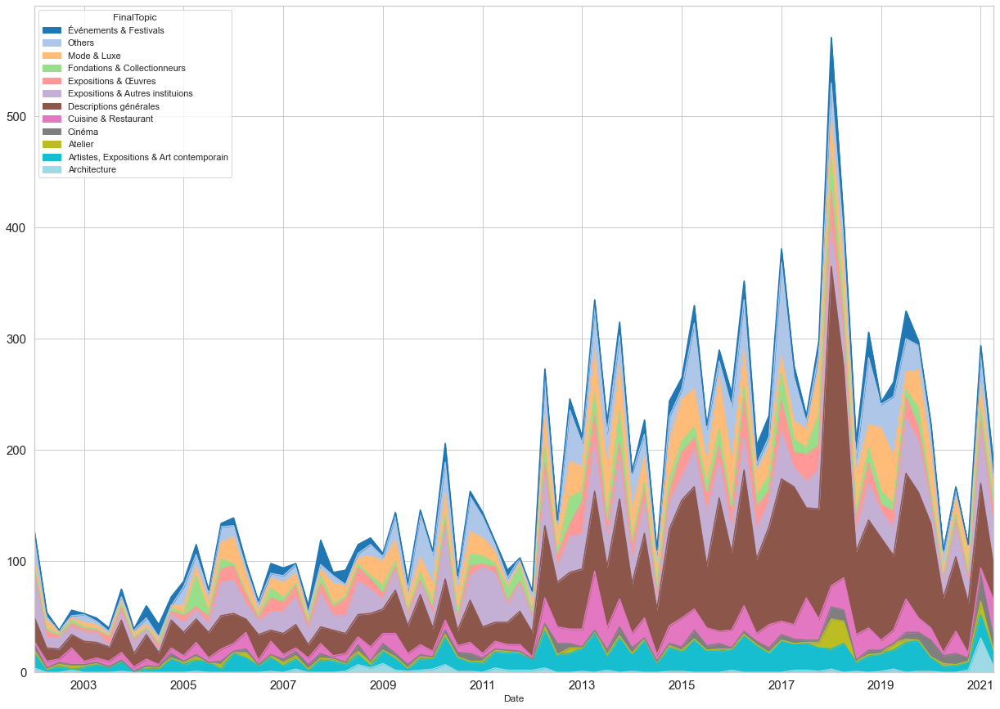

In [671]:
fr_frq_finaltopic.groupby(['FinalTopic']).resample('q').size().T.plot.area(stacked=True, figsize=(21,15), fontsize=15, rot=0,colormap='tab20_r', legend='reverse')


In [652]:
#plot_df = fr_frq_finaltopic.groupby(['FinalTopic']).resample('m').size().unstack('FinalTopic')
#plot_df = plot_df.divide(plot_df.sum(axis=1),axis=0)
#plot_df.plot.area(stacked=True, figsize=(35,25), fontsize=20, rot=0,colormap='tab20_r').legend(fontsize = 18,bbox_to_anchor=(1,.6))
#legend(fontsize = 15,ncol=2,bbox_to_anchor=(1,.7,0,.5))

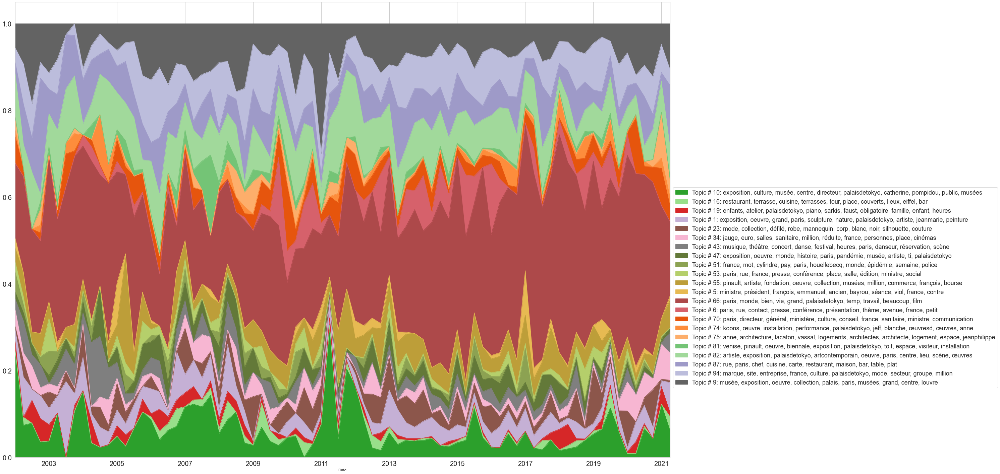

In [612]:
plot_df = fr_frq_topic.groupby(['TK']).resample('q').size().unstack('TK')
plot_df = plot_df.divide(plot_df.sum(axis=1),axis=0)
plot_df.plot.area(stacked=True, figsize=(35,25), fontsize=20, rot=0, 
                  colormap=cmap).legend(fontsize = 18,bbox_to_anchor=(1,.6))
#legend(fontsize = 15,ncol=2,bbox_to_anchor=(1,.7,0,.5))

In [425]:
fr_frq_topic

,Journal,Author,Title,Content,Language,LenContent,Year,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,TK
Date,,,,,,,,,,,,,
2002-01-26,Le Monde,BREERETTE GENEVIEVE,L'art contemporain dans le déglingué chic des ...,"AVEC SES PLÂTRES lacérés, ses murs de brique e...",fr,4710,2002,170,Topic # 1,0.3259,"exposition, oeuvre, grand, paris, sculpture, n...","[plâtres, lacérés, murs, brique, tuyaux, nu, n...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-02-08,NaN,CAROLINE SALLE,Le musée écrin du sculpteur Bouchard,Le temps s'est arrêté dans l'atelier du sculpt...,fr,4106,2002,190,Topic # 1,0.6571,"exposition, oeuvre, grand, paris, sculpture, n...","[temp, arrêté, atelier, sculpteur, henri, bouc...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-02-11,La Croix,CANITROT ARMELLE,La résistance de Marc Trivier PHOTOGRAPHIE Dou...,"Que devient le photographe Marc Trivier, dont ...",fr,5004,2002,194,Topic # 1,0.4595,"exposition, oeuvre, grand, paris, sculpture, n...","[devient, photographe, marc, trivier, guère, t...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-04-25,Sud Ouest,ALAIN BERNARD,Photo d'un crâneur à Séoul,SAINT-MEDARD D'EXCIDEUIL. Un artiste périgordi...,fr,2183,2002,242,Topic # 1,0.6942,"exposition, oeuvre, grand, paris, sculpture, n...","[saintmedard, excideuil, périgordin, présenter...","Topic # 1: exposition, oeuvre, grand, paris, s..."
2002-05-03,Sud Ouest,SABINE MENET,Création dynamique,MAI DES ARTS. L'Institution Sainte-Marthe-Sain...,fr,1468,2002,249,Topic # 1,0.3024,"exposition, oeuvre, grand, paris, sculpture, n...","[art, institution, saintemarthesaintfront, ini...","Topic # 1: exposition, oeuvre, grand, paris, s..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-19,Le Parisien,NaN,Où profiter des plus belles terrasses à Paris,Christine Henry C'est le retour des terrasse...,fr,3086,2021,13989,Topic # 94,0.3320,"marque, site, entreprise, france, culture, pal...","[christine, henry, terrasses, longs, fermeture...","Topic # 94: marque, site, entreprise, france, ..."
2021-05-19,Aujourd'hui en France,CHRISTINE HENRY,Réouverture des restaurants notre sélection d...,C'est le retour des terrasses ! Après six long...,fr,8225,2021,13990,Topic # 94,0.2276,"marque, site, entreprise, france, culture, pal...","[terrasses, longs, fermeture, restaurant, rouv...","Topic # 94: marque, site, entreprise, france, ..."
2021-05-23,La Nouvelle République,PBOULBEN,LOISIRS,"Avec le déconfinement de la culture, il y a em...",fr,931,2021,14010,Topic # 94,0.3596,"marque, site, entreprise, france, culture, pal...","[déconfinement, culture, embouteillage, exposi...","Topic # 94: marque, site, entreprise, france, ..."


In [426]:
def top_objet(objet,fr_frq_topic,top_num):
    pd_new = pd.DataFrame()
    df_count = fr_frq_topic[objet].value_counts().to_frame()
    df_count = df_count[objet].head(top_num).reset_index()
    df_count.columns = [objet,'Numbers']
    for i in df_count[objet]:
        pd_new = pd_new.append(fr_frq_topic.loc[fr_frq_topic[objet]==i]) 
    return pd_new    

In [911]:
topic_top = top_objet('Journal',fr_frq_topic,100)
co_mat_Journal_topic = pd.crosstab(topic_top.Journal, topic_top.TK,
                                   margins=True,margins_name="Total",normalize='index')
co_mat_Journal_topic

TK,"Topic # 10: exposition, culture, musée, centre, directeur, palaisdetokyo, catherine, pompidou, public, musées","Topic # 16: restaurant, terrasse, cuisine, terrasses, tour, place, couverts, lieux, eiffel, bar","Topic # 19: enfants, atelier, palaisdetokyo, piano, sarkis, faust, obligatoire, famille, enfant, heures","Topic # 1: exposition, oeuvre, grand, paris, sculpture, nature, palaisdetokyo, artiste, jeanmarie, peinture","Topic # 23: mode, collection, défilé, robe, mannequin, corp, blanc, noir, silhouette, couture","Topic # 34: jauge, euro, salles, sanitaire, million, réduite, france, personnes, place, cinémas","Topic # 43: musique, théâtre, concert, danse, festival, heures, paris, danseur, réservation, scène","Topic # 47: exposition, oeuvre, monde, histoire, paris, pandémie, musée, artiste, ti, palaisdetokyo","Topic # 51: france, mot, cylindre, pay, paris, houellebecq, monde, épidémie, semaine, police","Topic # 53: paris, rue, france, presse, conférence, place, salle, édition, ministre, social",...,"Topic # 66: paris, monde, bien, vie, grand, palaisdetokyo, temp, travail, beaucoup, film","Topic # 6: paris, rue, contact, presse, conférence, présentation, thème, avenue, france, petit","Topic # 70: paris, directeur, général, ministère, culture, conseil, france, sanitaire, ministre, communication","Topic # 74: koons, œuvre, installation, performance, palaisdetokyo, jeff, blanche, œuvresd, œuvres, anne","Topic # 75: anne, architecture, lacaton, vassal, logements, architectes, architecte, logement, espace, jeanphilippe","Topic # 81: venise, pinault, oeuvre, biennale, exposition, palaisdetokyo, toit, espace, visiteur, installation","Topic # 82: artiste, exposition, palaisdetokyo, artcontemporain, oeuvre, paris, centre, lieu, scène, œuvres","Topic # 87: rue, paris, chef, cuisine, carte, restaurant, maison, bar, table, plat","Topic # 94: marque, site, entreprise, france, culture, palaisdetokyo, mode, secteur, groupe, million","Topic # 9: musée, exposition, oeuvre, collection, palais, paris, musées, grand, centre, louvre"
Journal,,,,,,,,,,,,,,,,,,,,,
20 Minutes,0.035294,0.000000,0.000000,0.023529,0.035294,0.011765,0.011765,0.035294,0.000000,0.011765,...,0.376471,0.035294,0.011765,0.035294,0.000000,0.011765,0.035294,0.070588,0.094118,0.070588
A Markets,0.076923,0.009615,0.000000,0.019231,0.019231,0.004808,0.019231,0.033654,0.004808,0.004808,...,0.197115,0.072115,0.038462,0.004808,0.004808,0.009615,0.245192,0.038462,0.067308,0.048077
AFP,0.089947,0.005291,0.005291,0.005291,0.031746,0.021164,0.026455,0.015873,0.015873,0.068783,...,0.259259,0.042328,0.042328,0.005291,0.010582,0.010582,0.068783,0.052910,0.100529,0.052910
Agence France Presse,0.079304,0.003868,0.005803,0.021277,0.048356,0.017408,0.029014,0.027079,0.056093,0.108317,...,0.191489,0.025145,0.050290,0.013540,0.009671,0.007737,0.081238,0.021277,0.071567,0.061896
All Africa Global Media,0.043478,0.000000,0.000000,0.000000,0.086957,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.304348,0.043478,0.000000,0.000000,0.000000,0.000000,0.217391,0.043478,0.000000,0.086957
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Télérama,0.048951,0.006993,0.009324,0.044289,0.030303,0.023310,0.020979,0.025641,0.006993,0.004662,...,0.335664,0.027972,0.018648,0.011655,0.006993,0.006993,0.086247,0.086247,0.055944,0.088578
Valeurs Actuelles,0.085714,0.000000,0.000000,0.057143,0.057143,0.000000,0.000000,0.085714,0.028571,0.000000,...,0.228571,0.028571,0.000000,0.000000,0.000000,0.000000,0.057143,0.085714,0.085714,0.171429
Vivre Côté Paris,0.000000,0.000000,0.000000,0.045455,0.022727,0.000000,0.022727,0.000000,0.000000,0.000000,...,0.340909,0.045455,0.045455,0.022727,0.000000,0.000000,0.090909,0.136364,0.090909,0.090909


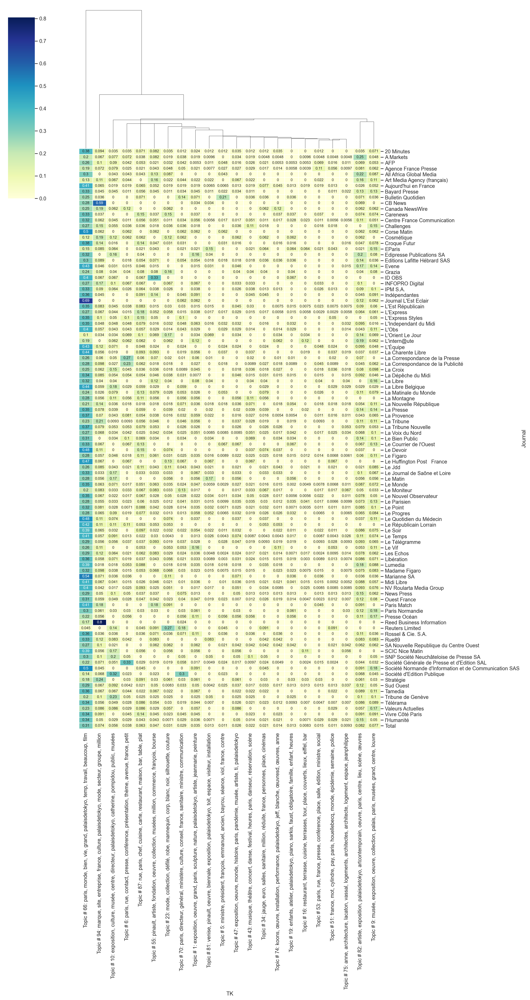

In [898]:
import matplotlib.pyplot as plt
sns.set(rc={"figure.dpi":200, 'savefig.dpi':300})
sns.clustermap(co_mat_Journal_topic, figsize=(16,30),cmap="YlGnBu",linewidths=.5,
               method='centroid',metric='euclidean',row_cluster=False,
              annot=True,annot_kws={'size':8,'weight':'normal'})

In [899]:
from scipy import stats
chi2 = stats.chi2_contingency(co_mat_Journal_topic)
chi2

(89.9726205686381,
 1.0,
 2100,
 array([[0.0571851 , 0.00668498, 0.01340545, ..., 0.05528306, 0.08794347,
         0.07038422],
        [0.0571851 , 0.00668498, 0.01340545, ..., 0.05528306, 0.08794347,
         0.07038422],
        [0.0571851 , 0.00668498, 0.01340545, ..., 0.05528306, 0.08794347,
         0.07038422],
        ...,
        [0.0571851 , 0.00668498, 0.01340545, ..., 0.05528306, 0.08794347,
         0.07038422],
        [0.0571851 , 0.00668498, 0.01340545, ..., 0.05528306, 0.08794347,
         0.07038422],
        [0.0571851 , 0.00668498, 0.01340545, ..., 0.05528306, 0.08794347,
         0.07038422]]))

In [71]:
#import matplotlib.pyplot as plt
#fig, ax = plt.subplots(figsize=(20,18)) 
#sns.heatmap(co_mat_Journal_topic, cmap="YlGnBu",linewidths=.5)

In [900]:
topic_top = top_objet('Journal',fr_frq_topic,50)
co_mat_Journal_topic = pd.crosstab(topic_top.Journal, topic_top.TK)
co_mat_Journal_topic

TK,"Topic # 10: exposition, culture, musée, centre, directeur, palaisdetokyo, catherine, pompidou, public, musées","Topic # 16: restaurant, terrasse, cuisine, terrasses, tour, place, couverts, lieux, eiffel, bar","Topic # 19: enfants, atelier, palaisdetokyo, piano, sarkis, faust, obligatoire, famille, enfant, heures","Topic # 1: exposition, oeuvre, grand, paris, sculpture, nature, palaisdetokyo, artiste, jeanmarie, peinture","Topic # 23: mode, collection, défilé, robe, mannequin, corp, blanc, noir, silhouette, couture","Topic # 34: jauge, euro, salles, sanitaire, million, réduite, france, personnes, place, cinémas","Topic # 43: musique, théâtre, concert, danse, festival, heures, paris, danseur, réservation, scène","Topic # 47: exposition, oeuvre, monde, histoire, paris, pandémie, musée, artiste, ti, palaisdetokyo","Topic # 51: france, mot, cylindre, pay, paris, houellebecq, monde, épidémie, semaine, police","Topic # 53: paris, rue, france, presse, conférence, place, salle, édition, ministre, social",...,"Topic # 66: paris, monde, bien, vie, grand, palaisdetokyo, temp, travail, beaucoup, film","Topic # 6: paris, rue, contact, presse, conférence, présentation, thème, avenue, france, petit","Topic # 70: paris, directeur, général, ministère, culture, conseil, france, sanitaire, ministre, communication","Topic # 74: koons, œuvre, installation, performance, palaisdetokyo, jeff, blanche, œuvresd, œuvres, anne","Topic # 75: anne, architecture, lacaton, vassal, logements, architectes, architecte, logement, espace, jeanphilippe","Topic # 81: venise, pinault, oeuvre, biennale, exposition, palaisdetokyo, toit, espace, visiteur, installation","Topic # 82: artiste, exposition, palaisdetokyo, artcontemporain, oeuvre, paris, centre, lieu, scène, œuvres","Topic # 87: rue, paris, chef, cuisine, carte, restaurant, maison, bar, table, plat","Topic # 94: marque, site, entreprise, france, culture, palaisdetokyo, mode, secteur, groupe, million","Topic # 9: musée, exposition, oeuvre, collection, palais, paris, musées, grand, centre, louvre"
Journal,,,,,,,,,,,,,,,,,,,,,
20 Minutes,3,0,0,2,3,1,1,3,0,1,...,32,3,1,3,0,1,3,6,8,6
A Markets,16,2,0,4,4,1,4,7,1,1,...,41,15,8,1,1,2,51,8,14,10
AFP,17,1,1,1,6,4,5,3,3,13,...,49,8,8,1,2,2,13,10,19,10
Agence France Presse,41,2,3,11,25,9,15,14,29,56,...,99,13,26,7,5,4,42,11,37,32
Aujourd'hui en France,3,3,2,3,3,12,3,2,2,3,...,64,3,3,7,0,1,4,10,10,8
Bayard Presse,4,0,0,4,1,0,1,3,1,0,...,29,1,3,0,2,1,12,5,4,12
Centre France Communication,8,4,5,10,2,2,9,3,1,2,...,57,2,6,3,1,1,19,10,11,9
Challenges,3,0,0,1,2,1,6,2,1,1,...,15,2,2,0,0,0,0,2,8,8
Croque Futur,1,0,1,0,2,0,0,1,0,0,...,24,0,2,1,1,0,3,9,9,5


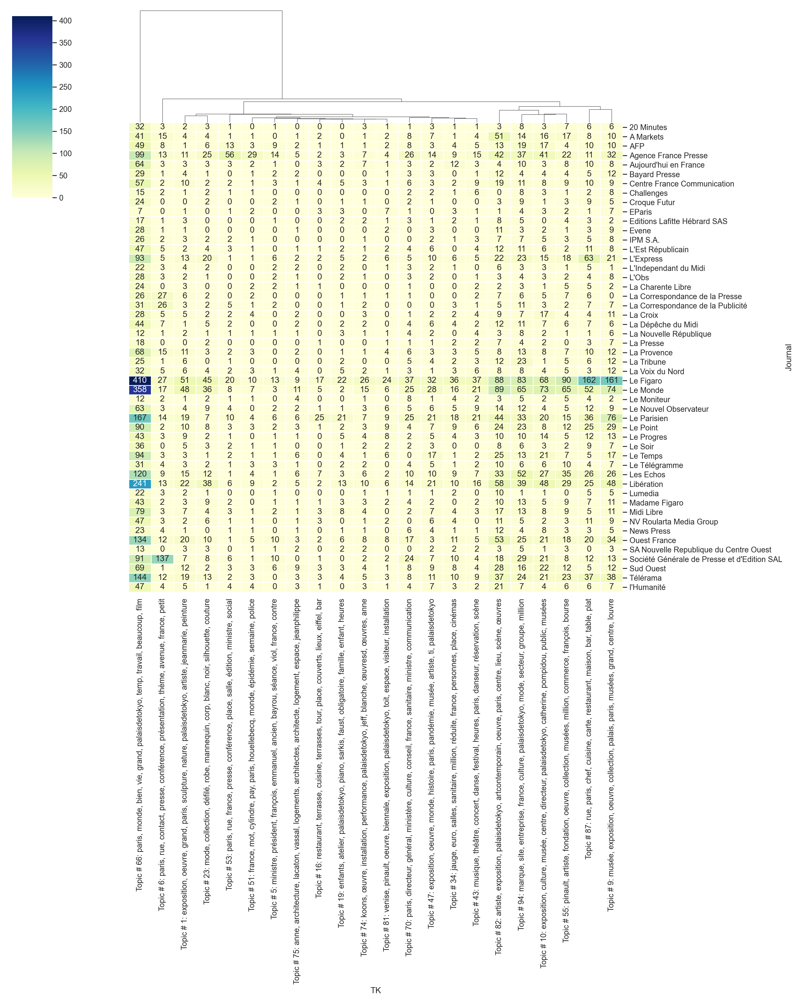

In [901]:
import matplotlib.pyplot as plt


sns.clustermap(co_mat_Journal_topic, figsize=(16,20),cmap="YlGnBu",linewidths=.5,
               annot=True, fmt="d",method='centroid',row_cluster=False)


In [2025]:
journal_top = top_objet('Journal',fr_frq_topic,10)
co_mat_journal_topic = pd.crosstab([journal_top.Journal, journal_top.TK],journal_top.Year,normalize='index')
co_mat_journal_topic

Year                                                                     2002.0  \
Journal              TK                                                           
Agence France Presse Topic # 10: exposition, culture, musée, centre,...     0.0   
                     Topic # 16: restaurant, terrasse, cuisine, terr...     0.0   
                     Topic # 19: enfants, atelier, palaisdetokyo, pi...     0.0   
                     Topic # 1: exposition, oeuvre, grand, paris, sc...     0.0   
                     Topic # 23: mode, collection, défilé, robe, man...     0.0   
...                                                                         ...   
Télérama             Topic # 81: venise, pinault, oeuvre, biennale, ...     0.0   
                     Topic # 82: artiste, exposition, palaisdetokyo,...     0.0   
                     Topic # 87: rue, paris, chef, cuisine, carte, r...     0.0   
                     Topic # 94: marque, site, entreprise, france, c...     0.0   
                     Topic # 9: musée, exposition, oeuvre, collectio...     0.0   

Year                                                                       2003.0  \
Journal              TK                                                             
Agence France Presse Topic # 10: exposition, culture, musée, centre,...  0.032258   
                     Topic # 16: restaurant, terrasse, cuisine, terr...  0.000000   
                     Topic # 19: enfants, atelier, palaisdetokyo, pi...  0.000000   
                     Topic # 1: exposition, oeuvre, grand, paris, sc...  0.000000   
                     Topic # 23: mode, collection, défilé, robe, man...  0.000000   
...                                                                           ...   
Télérama             Topic # 81: venise, pinault, oeuvre, biennale, ...  0.000000   
                     Topic # 82: artiste, exposition, palaisdetokyo,...  0.071429   
                     Topic # 87: rue, paris, chef, cuisine, carte, r...  0.153846   
                     Topic # 94: marque, site, entreprise, france, c...  0.000000   
                     Topic # 9: musée, exposition, oeuvre, collectio...  0.000000   

Year                                                                       2004.0  \
Journal              TK                                                             
Agence France Presse Topic # 10: exposition, culture, musée, centre,...  0.000000   
                     Topic # 16: restaurant, terrasse, cuisine, terr...  0.000000   
                     Topic # 19: enfants, atelier, palaisdetokyo, pi...  0.200000   
                     Topic # 1: exposition, oeuvre, grand, paris, sc...  0.000000   
                     Topic # 23: mode, collection, défilé, robe, man...  0.000000   
...                                                                           ...   
Télérama             Topic # 81: venise, pinault, oeuvre, biennale, ...  0.000000   
                     Topic # 82: artiste, exposition, palaisdetokyo,...  0.119048   
                     Topic # 87: rue, paris, chef, cuisine, carte, r...  0.115385   
                     Topic # 94: marque, site, entreprise, france, c...  0.000000   
                     Topic # 9: musée, exposition, oeuvre, collectio...  0.026316   

Year                                                                       2005.0  \
Journal              TK                                                             
Agence France Presse Topic # 10: exposition, culture, musée, centre,...  0.064516   
                     Topic # 16: restaurant, terrasse, cuisine, terr...  0.000000   
                     Topic # 19: enfants, atelier, palaisdetokyo, pi...  0.000000   
                     Topic # 1: exposition, oeuvre, grand, paris, sc...  0.000000   
                     Topic # 23: mode, collection, défilé, robe, man...  0.043478   
...                                                                           ...   
Télérama             Topic #

In [1312]:
#import matplotlib.pyplot as plt
#fig, ax = plt.subplots(figsize=(15,30))   
#sns.heatmap(co_mat_journal_topic, cmap="YlGnBu",linewidths=.5)

In [2037]:
import matplotlib.pyplot as plt
#fig, ax = plt.subplots(figsize=(15,30))   
sns.clustermap(co_mat_journal_topic, cmap="YlGnBu",figsize=(90,140),linewidths=.5,
              method='centroid',col_cluster=False)

In [1203]:
#author_top = top_objet('Author',fr_frq_topic,30)
#co_mat_a_topic = pd.crosstab(author_top.Author, author_top.Dominant_Topic)
#co_mat_a_topic

In [1202]:
#import matplotlib.pyplot as plt
#fig, ax = plt.subplots(figsize=(12,12))   
#sns.heatmap(co_mat_a_topic, cmap="YlGnBu",annot=True, fmt="d")

In [904]:
y_top = top_objet('Journal',fr_frq_topic,10)
co_mat_year_topic = pd.crosstab(y_top.TK,y_top.Year,
                                margins=True,margins_name="Total",normalize='index')
co_mat_year_topic

Year,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
TK,,,,,,,,,,,,,,,,,,,,
"Topic # 10: exposition, culture, musée, centre, directeur, palaisdetokyo, catherine, pompidou, public, musées",0.039437,0.025352,0.019718,0.045070,0.042254,0.076056,0.047887,0.033803,0.030986,0.101408,0.059155,0.045070,0.039437,0.081690,0.042254,0.056338,0.028169,0.118310,0.016901,0.050704
"Topic # 16: restaurant, terrasse, cuisine, terrasses, tour, place, couverts, lieux, eiffel, bar",0.015152,0.000000,0.000000,0.000000,0.090909,0.030303,0.106061,0.075758,0.015152,0.030303,0.151515,0.106061,0.015152,0.060606,0.015152,0.045455,0.015152,0.136364,0.000000,0.090909
"Topic # 19: enfants, atelier, palaisdetokyo, piano, sarkis, faust, obligatoire, famille, enfant, heures",0.101266,0.037975,0.000000,0.101266,0.050633,0.050633,0.075949,0.025316,0.050633,0.037975,0.075949,0.050633,0.025316,0.025316,0.000000,0.025316,0.189873,0.037975,0.000000,0.037975
"Topic # 1: exposition, oeuvre, grand, paris, sculpture, nature, palaisdetokyo, artiste, jeanmarie, peinture",0.022222,0.044444,0.035556,0.026667,0.066667,0.057778,0.057778,0.004444,0.026667,0.040000,0.031111,0.115556,0.066667,0.080000,0.066667,0.093333,0.040000,0.071111,0.040000,0.013333
"Topic # 23: mode, collection, défilé, robe, mannequin, corp, blanc, noir, silhouette, couture",0.004673,0.009346,0.028037,0.032710,0.014019,0.037383,0.046729,0.051402,0.070093,0.042056,0.098131,0.098131,0.037383,0.079439,0.074766,0.028037,0.051402,0.130841,0.065421,0.000000
"Topic # 34: jauge, euro, salles, sanitaire, million, réduite, france, personnes, place, cinémas",0.029630,0.007407,0.037037,0.029630,0.014815,0.059259,0.029630,0.059259,0.074074,0.037037,0.081481,0.044444,0.022222,0.074074,0.037037,0.044444,0.081481,0.051852,0.111111,0.074074
"Topic # 43: musique, théâtre, concert, danse, festival, heures, paris, danseur, réservation, scène",0.057143,0.050000,0.107143,0.057143,0.071429,0.007143,0.064286,0.014286,0.057143,0.007143,0.035714,0.042857,0.085714,0.078571,0.078571,0.050000,0.085714,0.028571,0.007143,0.014286
"Topic # 47: exposition, oeuvre, monde, histoire, paris, pandémie, musée, artiste, ti, palaisdetokyo",0.019108,0.019108,0.031847,0.057325,0.063694,0.031847,0.070064,0.025478,0.012739,0.000000,0.057325,0.044586,0.050955,0.108280,0.101911,0.140127,0.121019,0.031847,0.006369,0.006369
"Topic # 51: france, mot, cylindre, pay, paris, houellebecq, monde, épidémie, semaine, police",0.027397,0.041096,0.027397,0.054795,0.027397,0.013699,0.082192,0.095890,0.095890,0.013699,0.054795,0.109589,0.041096,0.109589,0.041096,0.123288,0.013699,0.013699,0.000000,0.013699


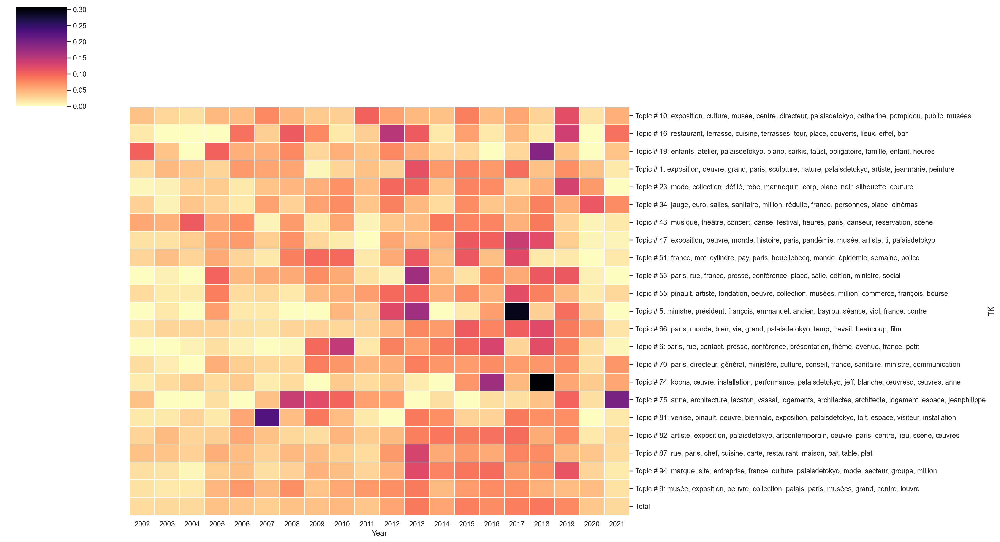

In [908]:
import matplotlib.pyplot as plt
#fig, ax = plt.subplots(figsize=(15,30))   
sns.clustermap(co_mat_year_topic, cmap="magma_r",figsize=(22, 12),linewidths=.5,
               method='centroid',col_cluster=False, row_cluster=False)

In [909]:
chi2 = stats.chi2_contingency(co_mat_year_topic)
chi2

(10.691525405539924,
 1.0,
 418,
 array([[0.02472321, 0.02101389, 0.02155169, 0.0437158 , 0.03986416,
         0.04115216, 0.04873762, 0.04812502, 0.05306925, 0.0344357 ,
         0.06239136, 0.08363575, 0.04835144, 0.06744854, 0.0664138 ,
         0.07881021, 0.08301451, 0.07307958, 0.02622674, 0.03423961],
        [0.02472321, 0.02101389, 0.02155169, 0.0437158 , 0.03986416,
         0.04115216, 0.04873762, 0.04812502, 0.05306925, 0.0344357 ,
         0.06239136, 0.08363575, 0.04835144, 0.06744854, 0.0664138 ,
         0.07881021, 0.08301451, 0.07307958, 0.02622674, 0.03423961],
        [0.02472321, 0.02101389, 0.02155169, 0.0437158 , 0.03986416,
         0.04115216, 0.04873762, 0.04812502, 0.05306925, 0.0344357 ,
         0.06239136, 0.08363575, 0.04835144, 0.06744854, 0.0664138 ,
         0.07881021, 0.08301451, 0.07307958, 0.02622674, 0.03423961],
        [0.02472321, 0.02101389, 0.02155169, 0.0437158 , 0.03986416,
         0.04115216, 0.04873762, 0.04812502, 0.05306925, 0.0344357 

In [2035]:
y_top = top_objet('Journal',fr_frq_topic,10)
co_mat_year_topic = pd.crosstab(journal_top.TK,journal_top.Year)
co_mat_year_topic

Year,2002.0,2003.0,2004.0,2005.0,2006.0,2007.0,2008.0,2009.0,2010.0,2011.0,2012.0,2013.0,2014.0,2015.0,2016.0,2017.0,2018.0,2019.0,2020.0,2021.0
TK,,,,,,,,,,,,,,,,,,,,
"Topic # 10: exposition, culture, musée, centre, directeur, palaisdetokyo, catherine, pompidou, public, musées",15,9,7,12,13,26,17,12,7,34,26,18,10,23,8,13,8,35,10,13
"Topic # 16: restaurant, terrasse, cuisine, terrasses, tour, place, couverts, lieux, eiffel, bar",0,0,0,0,8,2,3,9,1,1,5,6,1,3,1,3,5,5,0,0
"Topic # 19: enfants, atelier, palaisdetokyo, piano, sarkis, faust, obligatoire, famille, enfant, heures",6,3,1,7,3,3,7,1,3,3,4,3,3,3,0,3,20,4,1,5
"Topic # 1: exposition, oeuvre, grand, paris, sculpture, nature, palaisdetokyo, artiste, jeanmarie, peinture",8,8,6,11,10,12,11,1,12,4,7,21,17,13,20,19,11,13,2,7
"Topic # 23: mode, collection, défilé, robe, mannequin, corp, blanc, noir, silhouette, couture",2,2,6,5,4,7,9,9,11,5,13,24,7,18,18,11,13,23,12,0
"Topic # 34: jauge, euro, salles, sanitaire, million, réduite, france, personnes, place, cinémas",4,1,2,3,3,8,3,7,5,4,11,6,3,13,6,3,11,7,15,9
"Topic # 43: musique, théâtre, concert, danse, festival, heures, paris, danseur, réservation, scène",4,6,10,5,11,2,11,3,8,1,4,12,9,11,13,7,13,6,0,4
"Topic # 47: exposition, oeuvre, monde, histoire, paris, pandémie, musée, artiste, ti, palaisdetokyo",2,3,5,11,6,8,11,4,9,3,10,13,9,14,18,17,18,8,4,1
"Topic # 51: france, mot, cylindre, pay, paris, houellebecq, monde, épidémie, semaine, police",2,2,2,3,2,0,6,6,7,5,6,4,4,8,4,12,1,0,2,1


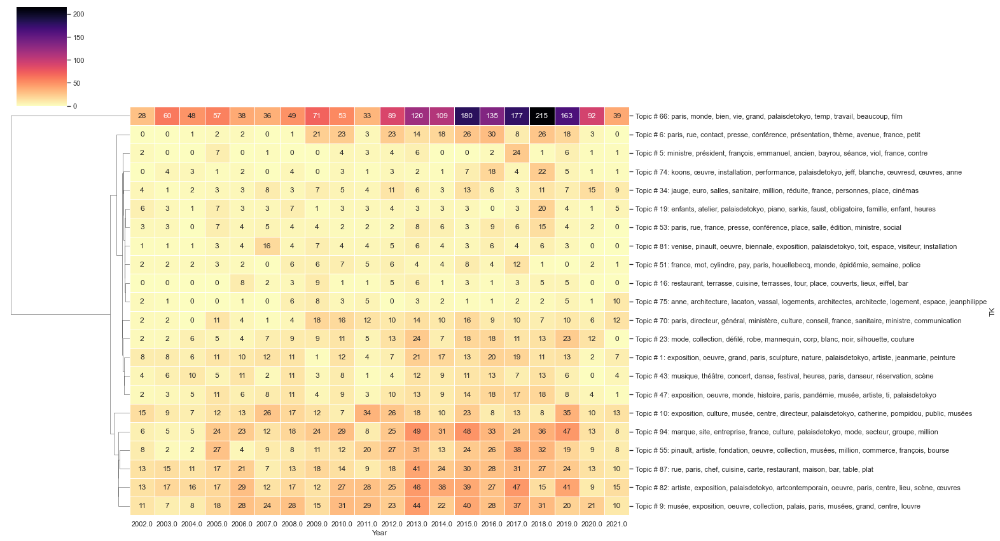

In [2036]:
import matplotlib.pyplot as plt
#fig, ax = plt.subplots(figsize=(15,30))   
sns.clustermap(co_mat_year_topic, cmap="magma_r",figsize=(22, 12),linewidths=.5,
               annot=True, fmt="d", method='centroid',col_cluster=False)

## co-occurence 
https://stackoverflow.com/questions/63236259/finding-top-3-dominant-topics-for-lda-topic-model

In [73]:
topic_num = 100
lda_model=ldamodel_fr
corpus=doc_term_matrix_fr

topics_df1 = pd.DataFrame()
topics_df2 = pd.DataFrame()
topics_df3 = pd.DataFrame()

for i, row_list in enumerate(lda_model[corpus]):
    row = row_list[0] if lda_model.per_word_topics else row_list            
    row = sorted(row, key=lambda x: (x[1]), reverse=True)
    for j, (topic_num, prop_topic) in enumerate(row):
        if len(row) >= 3:        
            if j ==0:
                topics_df1 = topics_df1.append(pd.Series([int(topic_num), prop_topic]), ignore_index=True)
            elif j ==1:
                topics_df2 = topics_df2.append(pd.Series([int(topic_num), prop_topic]), ignore_index=True)
            elif j ==2:
                topics_df3 = topics_df3.append(pd.Series([int(topic_num), prop_topic]), ignore_index=True)
            else:
                break
        elif len(row) == 2:
            if j ==0:
                topics_df1 = topics_df1.append(pd.Series([int(topic_num), prop_topic]), ignore_index=True)
            elif j ==1:
                topics_df2 = topics_df2.append(pd.Series([int(topic_num), prop_topic]), ignore_index=True)
                topics_df3 = topics_df3.append(pd.Series(['-', '-']), ignore_index=True)
        elif len(row) == 1:
                topics_df1 = topics_df1.append(pd.Series([int(topic_num), prop_topic]), ignore_index=True)
                topics_df2 = topics_df2.append(pd.Series(['-', '-']), ignore_index=True)  
                topics_df3 = topics_df3.append(pd.Series(['-', '-']), ignore_index=True)        
                
            
topics_df1.rename(columns={0:'1st Topic', 1:'1st Topic Contribution'}, inplace=True)
topics_df2.rename(columns={0:'2nd Topic', 1:'2nd Topic Contribution'}, inplace=True)
topics_df3.rename(columns={0:'3rd Topic', 1:'3rd Topic Contribution'}, inplace=True)

topics_comb = pd.concat([topics_df1, topics_df2, topics_df3],  axis=1, sort=False)

#Join topics dataframe to original data

In [74]:
#topics_comb = pd.concat([topics_df1, topics_df2, topics_df3],  axis=1, sort=False)
topics_comb

,1st Topic,1st Topic Contribution,2nd Topic,2nd Topic Contribution,3rd Topic,3rd Topic Contribution
0,86.0,0.407901,93.0,0.175237,33.0,0.121069
1,81.0,0.513306,54.0,0.149329,65.0,0.126068
2,81.0,0.518840,93.0,0.150774,9.0,0.098829
3,8.0,0.636921,26.0,0.170808,41.0,0.083105
4,65.0,0.589872,9.0,0.199831,74.0,0.055915
...,...,...,...,...,...,...
14088,4.0,0.262204,33.0,0.251316,50.0,0.221188
14089,65.0,0.251962,80.0,0.18665,0.0,0.168325
14090,86.0,0.667724,15.0,0.132112,26.0,0.057467
14091,86.0,0.377206,15.0,0.186265,0.0,0.114073


In [75]:
def change_labels(topics_comb):
    list_topic1 = []
    list_topic2 = []
    list_topic3 = []
    
    for i in topics_comb['1st Topic']:
        if i == i:
            i = ('Topic # ' + str(int(i)+1))
        else:
            i = i
        list_topic1.append(i)
    topics_comb['1st Topic'] = list_topic1
    
    for i in topics_comb['2nd Topic']:
        if i == '-':
            i = i
        elif i == i:
            i = ('Topic # ' + str(int(i)+1))
        else:
            i = i
        list_topic2.append(i)
    topics_comb['2nd Topic'] = list_topic2
    
    for i in topics_comb['3rd Topic']:
        if i == '-':
            i = i
        elif i == i:
            i = ('Topic # ' + str(int(i)+1))
        else:
            i = i
        list_topic3.append(i)
    topics_comb['3rd Topic'] = list_topic3
    topics_comb.index = topics_comb.index+1
    return topics_comb

In [77]:
#co_occurence = change_labels(topics_comb)
co_occurence

,1st Topic,1st Topic Contribution,2nd Topic,2nd Topic Contribution,3rd Topic,3rd Topic Contribution
1,Topic # 87,0.407901,Topic # 94,0.175237,Topic # 34,0.121069
2,Topic # 82,0.513306,Topic # 55,0.149329,Topic # 66,0.126068
3,Topic # 82,0.518840,Topic # 94,0.150774,Topic # 10,0.098829
4,Topic # 9,0.636921,Topic # 27,0.170808,Topic # 42,0.083105
5,Topic # 66,0.589872,Topic # 10,0.199831,Topic # 75,0.055915
...,...,...,...,...,...,...
14089,Topic # 5,0.262204,Topic # 34,0.251316,Topic # 51,0.221188
14090,Topic # 66,0.251962,Topic # 81,0.18665,Topic # 1,0.168325
14091,Topic # 87,0.667724,Topic # 16,0.132112,Topic # 27,0.057467
14092,Topic # 87,0.377206,Topic # 16,0.186265,Topic # 1,0.114073


In [78]:
co_occurence.columns = ['First_Topic', 'First_Topic_Contribution','Second_Topic', 
                       'Second_Topic_Contribution','Third_Topic', 'Third_Topic_Contribution']
co_occurence

,First_Topic,First_Topic_Contribution,Second_Topic,Second_Topic_Contribution,Third_Topic,Third_Topic_Contribution
1,Topic # 87,0.407901,Topic # 94,0.175237,Topic # 34,0.121069
2,Topic # 82,0.513306,Topic # 55,0.149329,Topic # 66,0.126068
3,Topic # 82,0.518840,Topic # 94,0.150774,Topic # 10,0.098829
4,Topic # 9,0.636921,Topic # 27,0.170808,Topic # 42,0.083105
5,Topic # 66,0.589872,Topic # 10,0.199831,Topic # 75,0.055915
...,...,...,...,...,...,...
14089,Topic # 5,0.262204,Topic # 34,0.251316,Topic # 51,0.221188
14090,Topic # 66,0.251962,Topic # 81,0.18665,Topic # 1,0.168325
14091,Topic # 87,0.667724,Topic # 16,0.132112,Topic # 27,0.057467
14092,Topic # 87,0.377206,Topic # 16,0.186265,Topic # 1,0.114073


In [79]:
co_occurence.loc[1]

First_Topic                  Topic # 87
First_Topic_Contribution       0.407901
Second_Topic                 Topic # 94
Second_Topic_Contribution      0.175237
Third_Topic                  Topic # 34
Third_Topic_Contribution       0.121069
Name: 1, dtype: object

In [90]:
def top_topic(objet,data,top_num):
    pd_new = pd.DataFrame()
    df_count = data[objet].value_counts().to_frame()
    df_count = df_count[objet].head(top_num).reset_index()
    df_count.columns = [objet,'Numbers']
    for i in df_count[objet]:
        pd_new = pd_new.append(data.loc[data[objet]==i]) 
    return pd_new 


https://www.kaggle.com/rtatman/co-occurrence-matrix-plot-in-python

In [914]:
topic_top = top_topic('First_Topic',co_occurence,40)
co_mat_topic = pd.crosstab( topic_top.First_Topic, topic_top.Second_Topic,normalize='index')
co_mat_topic = co_mat_topic.drop(['-'],axis=1)
co_mat_topic

Second_Topic,Topic # 1,Topic # 10,Topic # 100,Topic # 11,Topic # 13,Topic # 14,Topic # 15,Topic # 16,Topic # 17,Topic # 18,...,Topic # 89,Topic # 9,Topic # 90,Topic # 91,Topic # 92,Topic # 93,Topic # 94,Topic # 95,Topic # 98,Topic # 99
First_Topic,,,,,,,,,,,,,,,,,,,,,
Topic # 1,0.000000,0.017391,0.002174,0.000000,0.002174,0.000000,0.000000,0.008696,0.000000,0.000000,...,0.002174,0.104348,0.000000,0.000000,0.000000,0.000000,0.017391,0.00000,0.000000,0.010870
Topic # 10,0.017219,0.000000,0.000000,0.000000,0.013245,0.000000,0.000000,0.007947,0.000000,0.001325,...,0.000000,0.083444,0.001325,0.000000,0.000000,0.000000,0.117881,0.00000,0.000000,0.000000
Topic # 13,0.000000,0.172414,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.068966,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000
Topic # 16,0.028302,0.018868,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.037736,0.000000,0.000000,0.028302,0.000000,0.084906,0.00000,0.000000,0.000000
Topic # 19,0.034483,0.017241,0.000000,0.000000,0.000000,0.000000,0.000000,0.022989,0.000000,0.000000,...,0.000000,0.074713,0.000000,0.000000,0.000000,0.000000,0.109195,0.00000,0.000000,0.000000
Topic # 23,0.033735,0.009639,0.000000,0.000000,0.000000,0.000000,0.000000,0.002410,0.000000,0.000000,...,0.000000,0.031325,0.000000,0.000000,0.000000,0.000000,0.077108,0.00000,0.000000,0.000000
Topic # 26,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.038462,0.00000,0.000000,0.000000
Topic # 27,0.000000,0.000000,0.020833,0.000000,0.000000,0.000000,0.000000,0.041667,0.000000,0.000000,...,0.000000,0.187500,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000
Topic # 29,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.222222,0.000000,0.000000,0.000000,0.000000,0.222222,0.00000,0.000000,0.000000


<AxesSubplot:xlabel='First_Topic', ylabel='Second_Topic'>

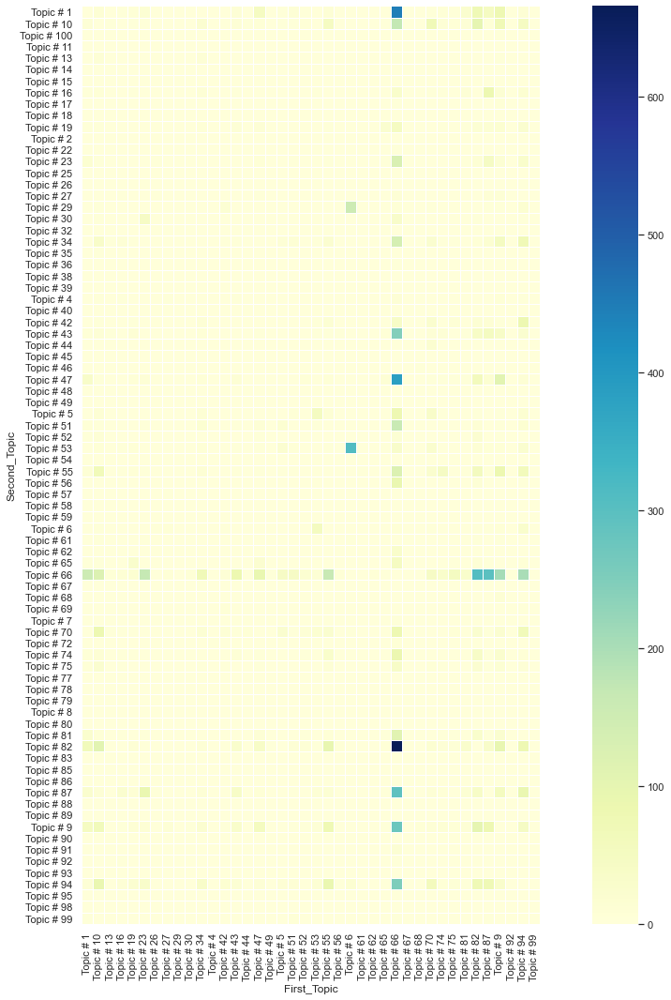

In [84]:
# plot heat map of co-occuance matrix
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(20,18))   

#sns.heatmap(co_mat, cmap = 'YlGnBu', annot=True, fmt=".1f")
sns.heatmap(co_mat_topic, cmap="YlGnBu", square = True, linewidths=.5)

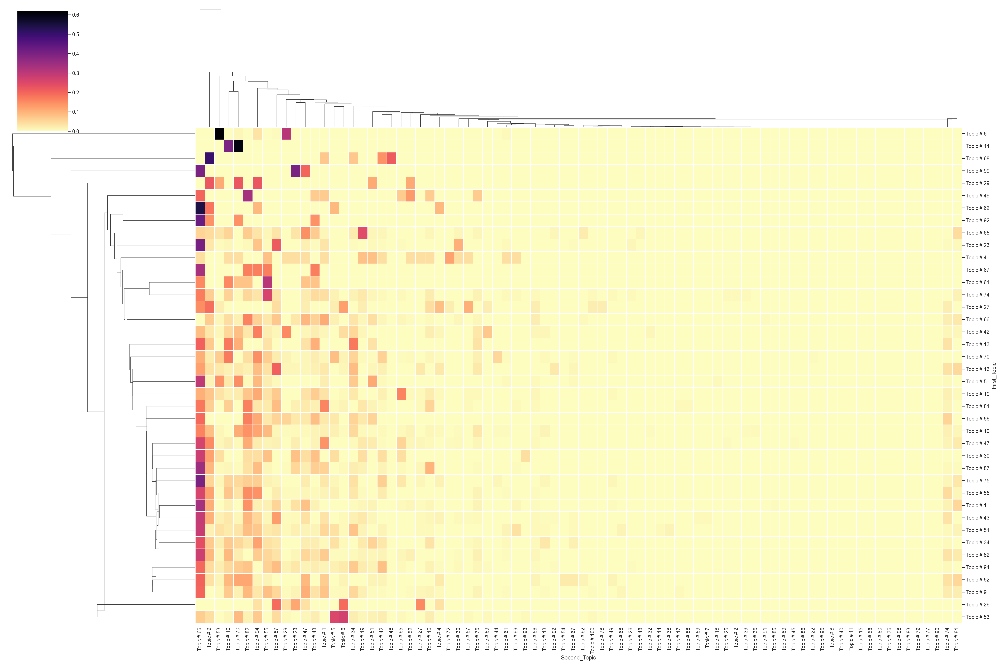

In [915]:
import matplotlib.pyplot as plt
#fig, ax = plt.subplots(figsize=(15,30))   
sns.clustermap(co_mat_topic, cmap="magma_r",figsize=(30, 20),linewidths=.5,
              method='centroid')

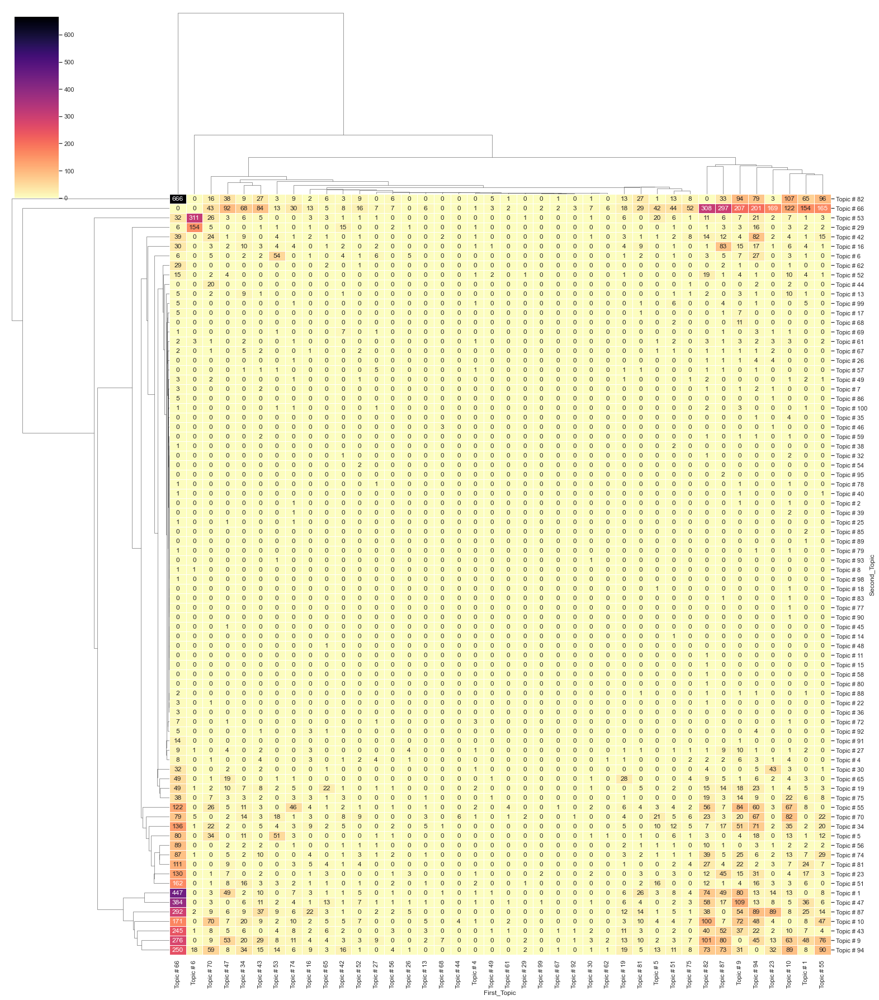

In [86]:
import matplotlib.pyplot as plt
#fig, ax = plt.subplots(figsize=(15,30)) 

sns.clustermap(co_mat_topic, cmap="magma_r",figsize=(22, 25),linewidths=.5,
              annot=True, fmt="d",method='centroid')